# Technical Challenge Notebook  
*by Rüçhan Ekren - Toulouse - 15/08/2025*

---

## Table of Contents

##### Task 1: **Comprehensive Analysis of Atlas-Level Colorectal Cancer Bulk RNA-seq Data**

**Objective:** Identify and characterize subpopulations within a batch-corrected colorectal cancer (CRC) bulk RNA-seq dataset and matching clinical dataset.

1. [Setup & Configuration](#1-setup--configuration)

2. [Exploratory Analysis](#2-exploratory-analysis)

3. [Unsupervised Clustering & Visualization](#3-unsupervised-clustering--visualization)
   
      1. [Feature plots](#feature-plots)
   
      2. [Chi-Square test](#Chi-Square-Test)

4. [Differential Expression (DE) Analysis](#4-differential-expression-de-analysis)

5. [Pathway Enrichment Analysis](#5-pathway-enrichment-analysis)
   
      1. [GSEA results](#GSEA-results)
   
      2. [ORA results](#ORA-results)
   
6. [Survival Analysis](#6-survival-analysis)
   
7. [Concluding Notes](#7-Concluding-notes)


## Task 1: **Comprehensive Analysis of Atlas-Level Colorectal Cancer Bulk RNA-seq Data**



### 1. Setup & Configuration

#### **Environment Setup**

If this is the **first time** running the notebook, create a new working environment from the [`requirements.yaml`](https://code.visualstudio.com/) file within this reportository.

```bash
conda env create -f requirements.yaml
```
Then you can open up and use this notebook

#### **Development Environment**

The analysis was conducted in a freshly installed, isolated conda environment using:
*   [MS Visual Code](https://code.visualstudio.com/)
*   [Jupyter](https://marketplace.visualstudio.com/items?itemName=ms-toolsai.jupyter)
*   [Data Wrangler](https://marketplace.visualstudio.com/items?itemName=ms-toolsai.datawrangler)

Back to [Table of Contents](#table-of-contents)

---

In [29]:
# --- 1. Setup & Configuration ---

# Core Python and system utilities
import os
import re
import warnings

# Data handling and numerical computation
import numpy as np
import pandas as pd

# Missing data visualization
import missingno as msno

# Visualization
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go

# Machine learning, preprocessing, and dimensionality reduction
from scipy.spatial.distance import pdist, squareform
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
import umap

# Single-cell and high-dimensional data analysis
import scanpy as sc

# Differential expression and pathway analysis
from pydeseq2.dds import DeseqDataSet
from pydeseq2.ds import DeseqStats
from pydeseq2.default_inference import DefaultInference
import gseapy as gp

# --- Configure warnings and plotting defaults ---
warnings.filterwarnings('ignore')
sc.settings.set_figure_params(dpi=80, facecolor='white')

# Ensure figures directory exists
os.makedirs('figures', exist_ok=True)

# --- Input Files ---
GENE_EXPRESSION_FILE = 'provided_data/CRC_atlas_gene_expression_data.csv'
CLINICAL_DATA_FILE = 'provided_data/CRC_atlas_clinical_data.csv'

# Clinical metadata column definitions
SAMPLE_TYPE_COL = 'Sample type'
HEALTHY_SAMPLE_TYPE = 'Healthy sample'
CANCER_SAMPLE_TYPE = 'Primary cancer'
BIOPSY_SITE_COL = 'Biopsy site'
GENDER_COL = 'Gender'
AGE_COL = 'Age'
TUMOR_STAGE_COL = 'Stage'
CMS_COL = 'CMS'
KRAS_COLS = 'KRAS mutation'
BRAF_COLS = 'BRAF mutation'
TP53_COLS = 'TP53 mutation'
EGFR_COLS = 'EGFR mutated'  # intentional: column name is "EGFR mutated"
PRIOR_TREATMENT_COL = 'Prior treatment'

### 2. Exploratory Analysis

Load gene expression and clinical data.

Back to [Table of Contents](#table-of-contents)

---

In [30]:
# --- Exploratory Data Analysis (EDA) ---
print("\n--- EDA of Clinical Data ---")

# --- Load Clinical Data ---
clinical_df = pd.read_csv(CLINICAL_DATA_FILE, index_col=0)
print(f"Initial clinical data shape: {clinical_df.shape}")

# --- Clinical Data Descriptive Statistics (Categorical) ---
print(clinical_df.describe(include='object').T)
print(clinical_df.describe(include=np.number).T)


--- EDA of Clinical Data ---
Initial clinical data shape: (2770, 34)
                     count unique                           top  freq
Age category          1442      1                         Adult  1442
Biopsy subsite        1296      2                   Right colon   682
BRAF mutation          619      2                            WT   562
Biopsy site           2770      4                         Colon  1681
Biopsy timepoint      1425      2                  At diagnosis  1418
CMS                    581      5                          CMS2   224
Cancer type            631      1             Colorectal cancer   631
Distal vs proximal    1662      2                        Distal   980
Donor type            2770      2                         Tumor  1966
EGFR mutated           515      2                            WT   500
Grade                   79      3                            II    45
Histological subtype  1966     14                Adenocarcinoma   853
Histological type   

Visualizing missing values in the clinical dataset:


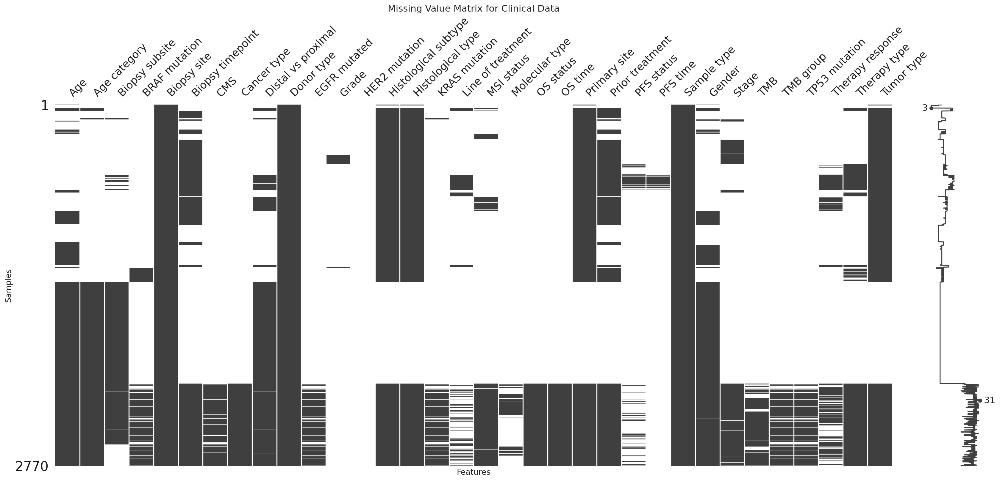

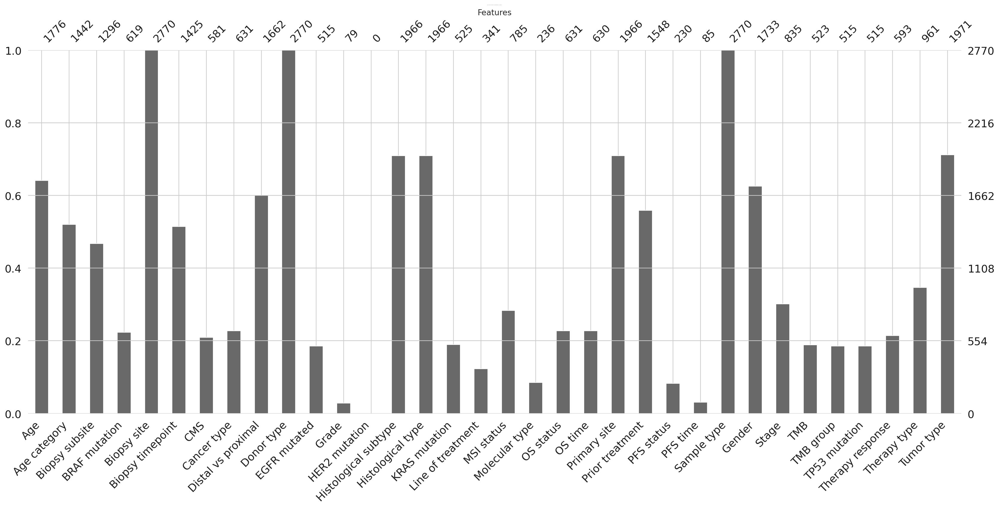

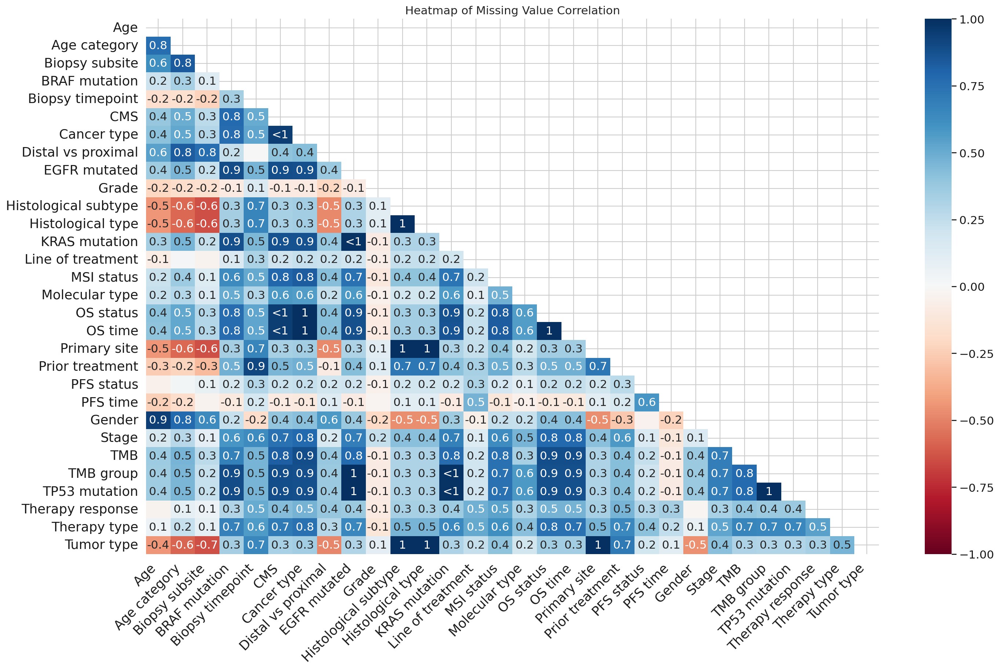

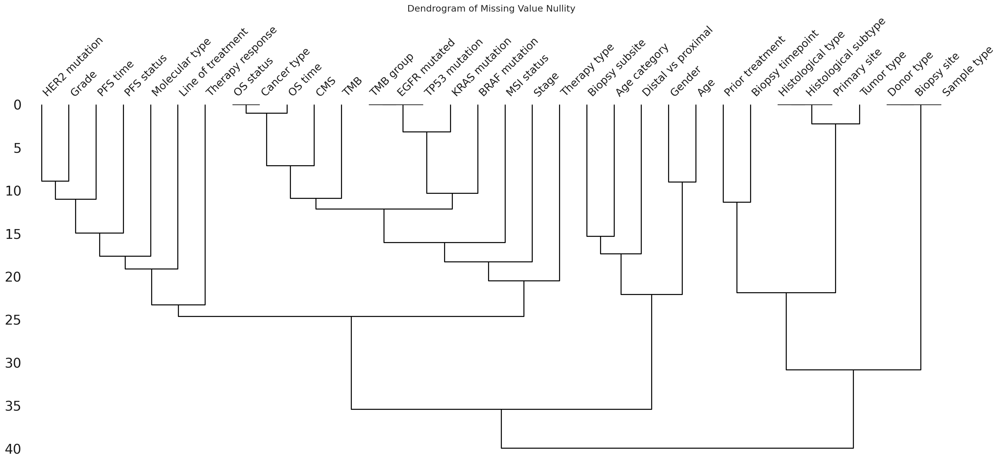


Missing value visualizations have been generated and saved as PNG files.


In [31]:
# --- Missing Value Visualizations ---

print("Visualizing missing values in the clinical dataset:")

# --- Missing Value Matrix ---
# This plot provides a high-level overview of where missing values occur.
# Each row is a sample, and each column is a feature.
# The white lines indicate missing data.
msno.matrix(clinical_df)
plt.title('Missing Value Matrix for Clinical Data', fontsize=14)
plt.xlabel('Features', fontsize=12)
plt.ylabel('Samples', fontsize=12)
plt.savefig('figures/clinical_missing_data_matrix.png', bbox_inches='tight')
plt.show()

# --- Missing Value Bar Chart ---
# This gives a simple count of the non-missing values in each column.
msno.bar(clinical_df)
plt.title('Bar Chart of Data Completeness by Feature', fontsize=1)
plt.xlabel('Features', fontsize=12)
plt.ylabel('Count of Non-Missing Values', fontsize=12)
plt.savefig('figures/clinical_missing_data_bar_chart.png', bbox_inches='tight')
plt.show()

# --- Missing Value Heatmap ---
# The heatmap shows the correlation of missingness between columns.
# A value of 1 means that if a value is missing in one column, it is also missing in the other.
# A value of -1 means that if a value is present in one column, it is missing in the other.
# A value of 0 means there is no correlation in missingness.
msno.heatmap(clinical_df)
plt.title('Heatmap of Missing Value Correlation', fontsize=14)
plt.savefig('figures/clinical_missing_data_heatmap.png', bbox_inches='tight')
plt.show()

# --- Missing Value Dendrogram ---
# The dendrogram shows hierarchical clustering of columns based on their nullity correlation.
# Columns that have similar patterns of missingness are grouped together.
msno.dendrogram(clinical_df)
plt.title('Dendrogram of Missing Value Nullity', fontsize=14)
plt.savefig('figures/clinical_missing_data_dendrogram.png', bbox_inches='tight')
plt.show()
print("\nMissing value visualizations have been generated and saved as PNG files.")

Based on the patterns of missing data in the clinical dataset, it is important to prioritize columns with high completeness for downstream analyses. These core variables offer the most reliable information and should form the foundation of our analysis.<br>  
Imputation is not recommended for variables with extensive or **non-random missingness**, as this may introduce bias.<br> 

For analyses that require additional clinical features, such as survival analysis, we should restrict to subsets of samples where these key columns are available, ensuring that results remain robust and interpretable.


In [ ]:

# --- Tier 1: Processing Core, High-Completeness Variables ---
print("\n--- Tier 1: Processing Core Variables ---")
processed_clinical_df = clinical_df.copy()

# Impute 'Age' with median value, to preserve data distribution
if 'Age' in processed_clinical_df.columns:
    print(f"Missing 'Age' values before: {processed_clinical_df['Age'].isnull().sum()}")
    imputer = SimpleImputer(strategy='median')
    processed_clinical_df['Age'] = imputer.fit_transform(processed_clinical_df[['Age']])
    print(f"Missing 'Age' values after: {processed_clinical_df['Age'].isnull().sum()}")

    # Add a categorical age groups for additional annotation, keeping NaN as NaN
CRC_AGE_GROUP_COL = 'CRC_Age_Group' # Categorical Age Group, we are going to add
AGE_COL = 'Age'  # Column containing age data

def assign_crc_age_group(Age):
    if pd.isna(Age):
        return pd.NA
    elif Age < 50:
        return "Young_adult"
    elif Age <= 64:
        return "Middle-aged"
    else:
        return "Older_adult"

clinical_df[CRC_AGE_GROUP_COL] = clinical_df[AGE_COL].apply(assign_crc_age_group)

    # Fill missing core categorical data with 'Unknown'
core_categorical_vars = ['Gender', 'Sample type', 'Primary site']
for col in core_categorical_vars:
    if col in processed_clinical_df.columns and processed_clinical_df[col].isnull().any():
        print(f"Filling {processed_clinical_df[col].isnull().sum()} missing values in '{col}' with 'Unknown'.")
        processed_clinical_df[col].fillna('Unknown', inplace=True)

# --- Tier 2: Creating Analysis-Specific Subsets ---
print("\n--- Tier 2: Creating Analysis-Specific Subsets ---")

# Survival Analysis Subset
survival_cols = ['OS time', 'OS status']
if all(col in processed_clinical_df.columns for col in survival_cols):
    survival_subset_df = processed_clinical_df.dropna(subset=survival_cols).copy()
    print(f"-> Created 'survival_subset_df' with {len(survival_subset_df)} samples for survival analysis.")

################################################################################################
# I have initially thought the potential use of these but couldn't find a quick way to implement them.
################################################################################################
# Mutation Analysis Subset
mutation_cols = ['KRAS mutation', 'BRAF mutation', 'TP53 mutation']
if all(col in processed_clinical_df.columns for col in mutation_cols):
    mutation_subset_df = processed_clinical_df.dropna(subset=mutation_cols).copy()
    print(f"-> Created 'mutation_subset_df' with {len(mutation_subset_df)} samples for mutation analysis.")

# CMS Analysis Subset
if 'CMS' in processed_clinical_df.columns:
    cms_subset_df = processed_clinical_df.dropna(subset=['CMS']).copy()
    print(f"-> Created 'cms_subset_df' with {len(cms_subset_df)} samples for CMS analysis.")

# --- Tier 3: Feature Engineering from Missingness ---
print("\n--- Tier 3: Engineering New Features from Missingness ---")

# Engineer 'MSI_status_engineered'
if 'MSI status' in processed_clinical_df.columns:
    processed_clinical_df['MSI_status_engineered'] = processed_clinical_df['MSI status'].fillna('Not Assayed')
    print("-> Created 'MSI_status_engineered' column in 'processed_clinical_df'.")

# Engineer 'Stage_engineered'
if 'Stage' in processed_clinical_df.columns:
    processed_clinical_df['Stage_engineered'] = processed_clinical_df['Stage'].fillna('Unknown')
    print("-> Created 'Stage_engineered' column in 'processed_clinical_df'.")

# --- Final Processed DataFrame ---
# 'processed_clinical_df' is now our primary metadata source for annotation and modeling.
print(f"\nClinical data processing complete. Final 'processed_clinical_df' shape: {processed_clinical_df.shape}")


--- Tier 1: Processing Core Variables ---
Missing 'Age' values before: 994
Missing 'Age' values after: 0
Filling 1037 missing values in 'Gender' with 'Unknown'.
Filling 804 missing values in 'Primary site' with 'Unknown'.

--- Tier 2: Creating Analysis-Specific Subsets ---
-> Created 'survival_subset_df' with 630 samples for survival analysis.
-> Created 'mutation_subset_df' with 515 samples for mutation analysis.
-> Created 'cms_subset_df' with 581 samples for CMS analysis.

--- Tier 3: Engineering New Features from Missingness ---
-> Created 'MSI_status_engineered' column in 'processed_clinical_df'.
-> Created 'Stage_engineered' column in 'processed_clinical_df'.

Clinical data processing complete. Final 'processed_clinical_df' shape: (2770, 36)


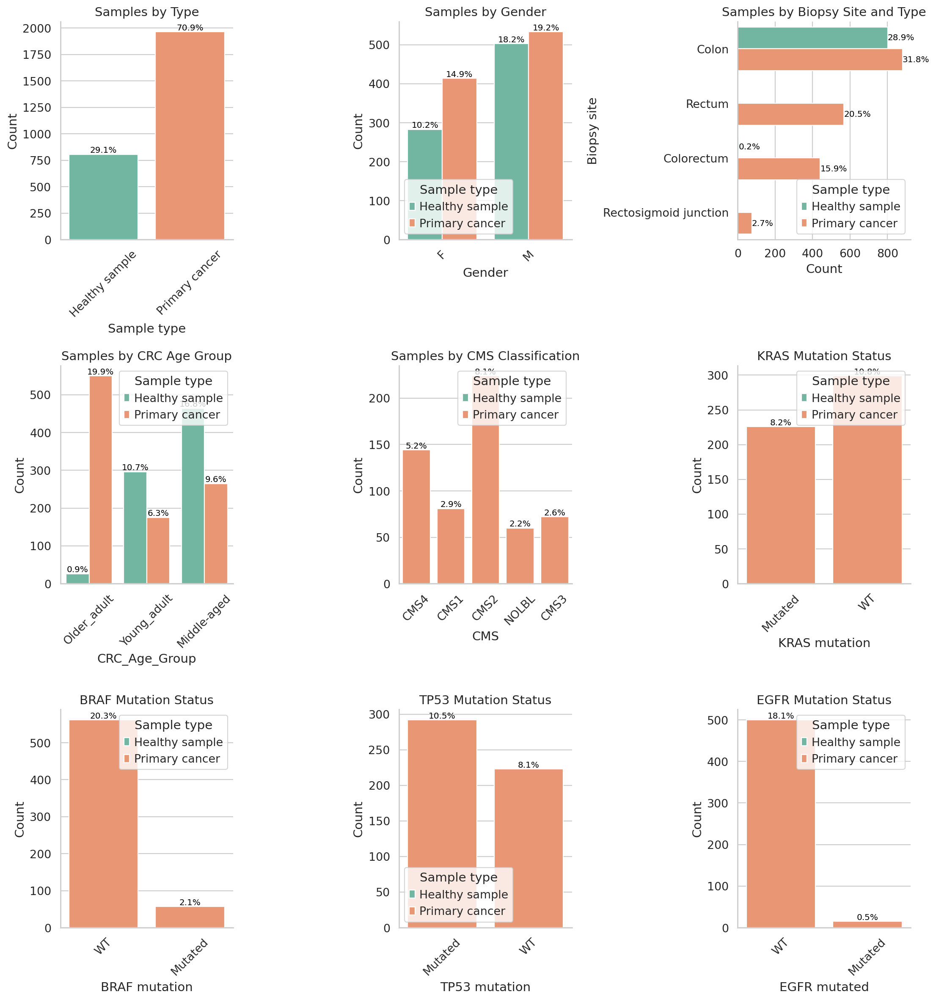

In [5]:
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.ticker import MultipleLocator, PercentFormatter

# Seaborn styling
sns.set_theme(style="whitegrid", font_scale=1.1)

# Parameters to plot
plot_params = [
    (SAMPLE_TYPE_COL, "Samples by Type", "x"),
    (GENDER_COL, "Samples by Gender", "x"),
    (BIOPSY_SITE_COL, "Samples by Biopsy Site and Type", "y"),
    (CRC_AGE_GROUP_COL, "Samples by CRC Age Group", "x"),
    (CMS_COL, "Samples by CMS Classification", "x"),
    (KRAS_COLS, "KRAS Mutation Status", "x"),
    (BRAF_COLS, "BRAF Mutation Status", "x"),
    (TP53_COLS, "TP53 Mutation Status", "x"),
    (EGFR_COLS, "EGFR Mutation Status", "x"),
]

# Determine grid size automatically
n_plots = sum(1 for col, _, _ in plot_params if col in clinical_df.columns)
n_cols = 3
n_rows = (n_plots + 1) // n_cols

fig = plt.figure(figsize=(14, 5 * n_rows))
gs = fig.add_gridspec(n_rows, n_cols, height_ratios=[1] * n_rows)

plot_idx = 0
for col_name, title, orientation in plot_params:
    if col_name not in clinical_df.columns:
        print(f"Warning: Column '{col_name}' not found in clinical data.")
        continue

    ax = fig.add_subplot(gs[plot_idx // n_cols, plot_idx % n_cols])

    # Countplot
    if orientation == "x":
        sns.countplot(x=col_name, hue=SAMPLE_TYPE_COL, data=clinical_df,
                      palette="Set2", ax=ax)
        ax.tick_params(axis='x', rotation=45)
        ax.set_ylabel("Count")
    else:
        sns.countplot(y=col_name, hue=SAMPLE_TYPE_COL, data=clinical_df,
                      palette="Set2", ax=ax)
        ax.set_xlabel("Count")

    # Title and aesthetics
    ax.set_title(title)
    sns.despine(ax=ax)

    # Add percentages on bars
    total_counts = len(clinical_df)
    for p in ax.patches:
        height = p.get_height() if orientation == "x" else p.get_width()
        if height > 0:
            percentage = f"{100 * height / total_counts:.1f}%"
            if orientation == "x":
                ax.annotate(percentage, (p.get_x() + p.get_width() / 2, height),
                            ha='center', va='bottom', fontsize=9, color='black')
            else:
                ax.annotate(percentage, (height, p.get_y() + p.get_height() / 2),
                            ha='left', va='center', fontsize=9, color='black')

    plot_idx += 1

plt.tight_layout()
plt.show()

In [6]:
# --- Loading and checking Gene expression Data ---

# Load gene expression data
gene_expression_df = pd.read_csv(GENE_EXPRESSION_FILE, index_col=0)


print("Data loading successful.")
print(f"Initial Gene Expression Data Shape: {gene_expression_df.shape}")

# Ensure samples are rows, genes are columns
if gene_expression_df.shape[0] > gene_expression_df.shape[1]:
    print("Transposing gene expression data: genes as rows → samples as rows.")
    gene_expression_df = gene_expression_df.T

# Handle missing values
gene_expression_df.fillna(0, inplace=True)
gene_expression_df = gene_expression_df.astype(int)
print("Missing values filled with 0 and cast to integers.")

import numpy as np
import pandas as pd

# --- Filtering Genes Based on Variance ---
print("--- Filtering lowly expressed/uninformative genes based on variance ---")

# --- Reporting before filtering ---
n_genes_before = gene_expression_df.shape[1]
total_counts_before = gene_expression_df.sum().sum()
median_counts_before = gene_expression_df.sum(axis=0).median()

# Step 1: Normalize data to stabilize variance.
# Using log2(counts + 1) to prevent high-expression genes from dominating
# the variance calculation simply due to their magnitude.
print("Applying log2(x+1) transformation for variance calculation...")
normalized_counts = np.log2(gene_expression_df + 1)

# Step 2: Calculate the variance for each gene across all samples.
print("Calculating variance for each gene on normalized data...")
gene_variances = normalized_counts.var(axis=0)

# Step 3: Identify the genes that collectively contribute to 99% of the total variance.
sorted_variances = gene_variances.sort_values(ascending=False)
total_variance = sorted_variances.sum()

if total_variance > 0:
    # Calculate the cumulative sum of variance and find the cutoff point
    cumulative_variance_ratio = sorted_variances.cumsum() / total_variance
    
    # Find the index of the first gene where the cumulative variance exceeds 99%
    # np.argmax returns the index of the first 'True' value.
    cutoff_index = np.argmax(cumulative_variance_ratio.values >= 0.99)

    # We keep all genes up to and including that gene.
    n_genes_to_keep = cutoff_index + 1
    genes_to_keep = sorted_variances.index[:n_genes_to_keep]
    
    # Apply the filter to the original, non-normalized count dataframe
    gene_expression_df = gene_expression_df.loc[:, genes_to_keep]

else:
    print("Warning: Total variance of the data is zero. No genes were filtered.")

# --- Reporting after filtering ---
n_genes_after = gene_expression_df.shape[1]
total_counts_after = gene_expression_df.sum().sum()
median_counts_after = gene_expression_df.sum(axis=0).median() if n_genes_after > 0 else 0

print("\n--- Filtering Report ---")
print(f"Genes before filtering: {n_genes_before:,}")
print(f"Genes after filtering (retaining 99% of total variance): {n_genes_after:,}")
if n_genes_before > 0:
    print(f"Removed {n_genes_before - n_genes_after:,} genes with the lowest variance "
          f"({(n_genes_before - n_genes_after) / n_genes_before:.1%} reduction).")
print(f"Total counts before: {total_counts_before:,}, median counts/gene: {median_counts_before:,.1f}")
print(f"Total counts after:  {total_counts_after:,}, median counts/gene: {median_counts_after:,.1f}")


Data loading successful.
Initial Gene Expression Data Shape: (22723, 2770)
Transposing gene expression data: genes as rows → samples as rows.
Missing values filled with 0 and cast to integers.
--- Filtering lowly expressed/uninformative genes based on variance ---
Applying log2(x+1) transformation for variance calculation...
Calculating variance for each gene on normalized data...

--- Filtering Report ---
Genes before filtering: 22,723
Genes after filtering (retaining 99% of total variance): 20,236
Removed 2,487 genes with the lowest variance (10.9% reduction).
Total counts before: 86,249,032,577, median counts/gene: 835,702.0
Total counts after:  86,245,355,655, median counts/gene: 1,284,838.0


This step filters out lowly expressed and uninformative genes variance after log2(x+1) transformation. Genes are retained to preserve 99% of total variance.

**Filtering Report:**
- Genes before filtering: 22,723  
- Genes after filtering: 20,236  
- Removed: 2,487 genes (10.9% reduction)  
- Total counts before: 86,249,032,577 (median/gene: 835,702)  
- Total counts after: 86,245,355,655 (median/gene: 1,284,838)

This data-driven approrach improves downstream reliability by focusing on the informative genes.

In [7]:
print("--- Unsupervised Discovery and Visualization ---")

# --- Global Structure & Outlier Detection via PCA ---
print("\n--- Performing PCA for a global overview ---")
scaler = StandardScaler()
scaled_expression_data = scaler.fit_transform(gene_expression_df)
pca = PCA(n_components=10)
principal_components = pca.fit_transform(scaled_expression_data)
pca_df = pd.DataFrame(
    data=principal_components, 
    index=gene_expression_df.index,
    columns=[f'PC{i+1}' for i in range(10)]
).join(processed_clinical_df)

# --- Outlier Flagging Logic (using 3 standard deviations) ---
print("\nIdentifying putative outliers based on 3 standard deviations...")
outlier_threshold = 3
putative_outliers_list = []
for pc in ['PC1', 'PC2']:
    mean, std = pca_df[pc].mean(), pca_df[pc].std()
    pc_outliers = pca_df[(pca_df[pc] > mean + outlier_threshold * std) |
                         (pca_df[pc] < mean - outlier_threshold * std)]
    putative_outliers_list.extend(pc_outliers.index)

putative_outliers = pd.Index(np.unique(putative_outliers_list))
pca_df['is_outlier'] = 'No'
pca_df.loc[putative_outliers, 'is_outlier'] = 'Yes'
print(f"Found and flagged {len(putative_outliers)} putative outlier samples.")

# Display clinical data for the putative outliers for manual review
if not putative_outliers.empty:
    print("\nClinical Data for Putative Outliers:")
    display(clinical_df.loc[putative_outliers])
else:
    print("No significant outliers were detected.")

# --- Visualize Outliers Before Removal ---
print("Generating interactive PCA plot with outliers highlighted...")
fig_pca = px.scatter(
    pca_df, x='PC1', y='PC2', color='Sample type', symbol='is_outlier',
    symbol_map={'No': 'circle', 'Yes': 'x'},
    hover_data=['Stage_engineered', 'Gender', 'Age', 'Biopsy site','CMS','BRAF mutation','EGFR mutated', 'KRAS mutation','TP53 mutation'],
    title='PCA of Gene Expression (with flagged Outliers)',
    labels={'PC1': f'PC1 ({pca.explained_variance_ratio_[0]:.1%} variance)',
            'PC2': f'PC2 ({pca.explained_variance_ratio_[1]:.1%} variance)'}
)
fig_pca.show()

# --- Active Removal of Outliers ---
print(f"\nRemoving {len(putative_outliers)} outlier samples...")
gene_expression_df_filt = gene_expression_df.drop(index=putative_outliers, errors='ignore')
processed_clinical_df = processed_clinical_df.drop(index=putative_outliers, errors='ignore')
print(f"Original sample count: {len(gene_expression_df)}. New sample count: {len(gene_expression_df_filt)}.")
gene_expression_df = gene_expression_df_filt
del(gene_expression_df_filt)  # Clean up to save memory

def assign_crc_age_group(Age):
    if pd.isna(Age):
        return pd.NA
    elif Age < 50:
        return "Young_adult"
    elif Age <= 64:
        return "Middle-aged"
    else:
        return "Older_adult"

processed_clinical_df[CRC_AGE_GROUP_COL] = processed_clinical_df[AGE_COL].apply(assign_crc_age_group)


--- Unsupervised Discovery and Visualization ---

--- Performing PCA for a global overview ---

Identifying putative outliers based on 3 standard deviations...
Found and flagged 16 putative outlier samples.

Clinical Data for Putative Outliers:


,Age,Age category,Biopsy subsite,BRAF mutation,Biopsy site,Biopsy timepoint,CMS,Cancer type,Distal vs proximal,Donor type,...,Sample type,Gender,Stage,TMB,TMB group,TP53 mutation,Therapy response,Therapy type,Tumor type,CRC_Age_Group
GSM2305777,NaN,NaN,NaN,NaN,Colon,At diagnosis,NaN,NaN,NaN,Tumor,...,Primary cancer,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Solid tumor,<NA>
GSM2305795,NaN,NaN,NaN,NaN,Colon,At diagnosis,NaN,NaN,NaN,Tumor,...,Primary cancer,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Solid tumor,<NA>
GSM2305798,NaN,NaN,NaN,NaN,Colon,At diagnosis,NaN,NaN,NaN,Tumor,...,Primary cancer,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Solid tumor,<NA>
GSM2305807,NaN,NaN,NaN,NaN,Colon,At diagnosis,NaN,NaN,NaN,Tumor,...,Primary cancer,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Solid tumor,<NA>
GTEX-131XG-1826-SM-5LZV4,54.0,Adult,Right colon,NaN,Colon,NaN,NaN,NaN,Proximal,Normal,...,Healthy sample,F,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Middle-aged
GTEX-139TS-2226-SM-5J2N1,64.0,Adult,Left colon,NaN,Colon,NaN,NaN,NaN,Distal,Normal,...,Healthy sample,M,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Middle-aged
GTEX-14BMU-1526-SM-5TDE6,24.0,Adult,Right colon,NaN,Colon,NaN,NaN,NaN,Proximal,Normal,...,Healthy sample,F,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Young_adult
GTEX-18A7A-2226-SM-7LT8K,54.0,Adult,Right colon,NaN,Colon,NaN,NaN,NaN,Proximal,Normal,...,Healthy sample,F,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Middle-aged
GTEX-1IDJU-1926-SM-CL53W,64.0,Adult,Left colon,NaN,Colon,NaN,NaN,NaN,Distal,Normal,...,Healthy sample,F,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Middle-aged
GTEX-1JKYN-2326-SM-CGQG7,34.0,Adult,Right colon,NaN,Colon,NaN,NaN,NaN,Proximal,Normal,...,Healthy sample,M,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Young_adult


Generating interactive PCA plot with outliers highlighted...



Removing 16 outlier samples...
Original sample count: 2770. New sample count: 2754.


In the PCA plot, healthy donor samples and primary cancer samples are clearly separated along PC1 and PC2.

Outlier detection using a ±3 SD threshold identified 16 samples (marked with **x**) as potential outliers. 

Clinical data review revealed no biologically relevant patterns for these samples, so they were excluded from further analysis.

Performing log1p transformation on expression data for visualization...
Generating color annotations and mappings for metadata...

--- Calling Visualization Functions ---
Generating Sample-to-Sample Distance Heatmap...
Saved sample distance heatmap to figures/sample_distance_heatmap_legends_outside.png


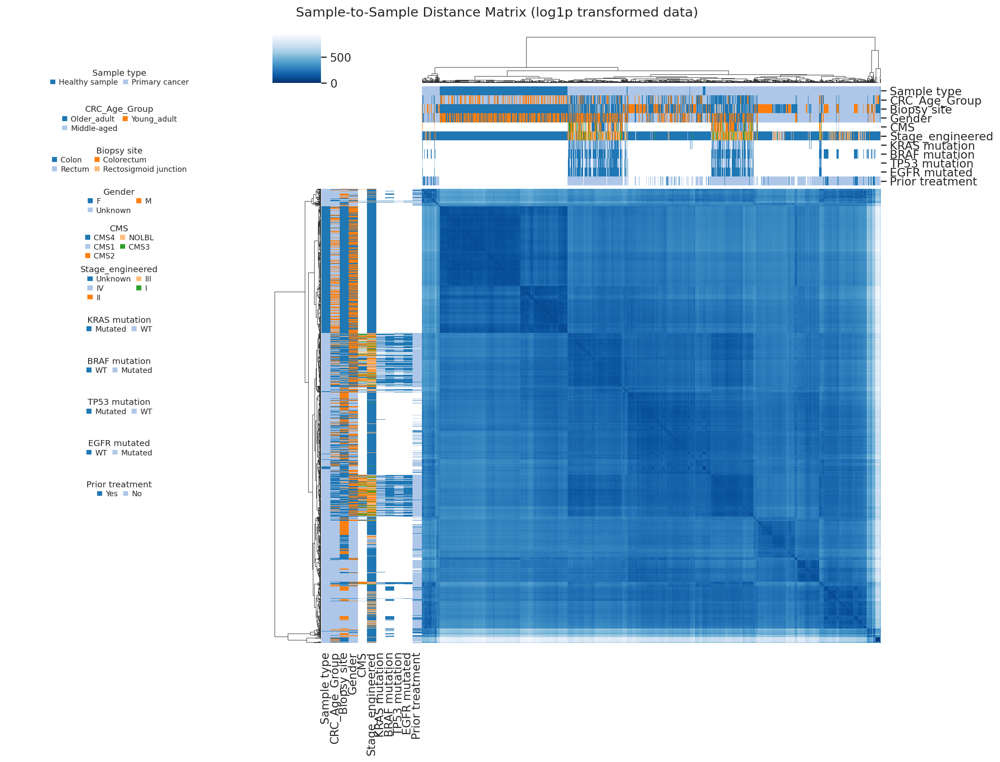

Generating heatmap for top 50 most variable genes...
Saved variable genes heatmap to figures/variable_genes_heatmap_legends_outside.png


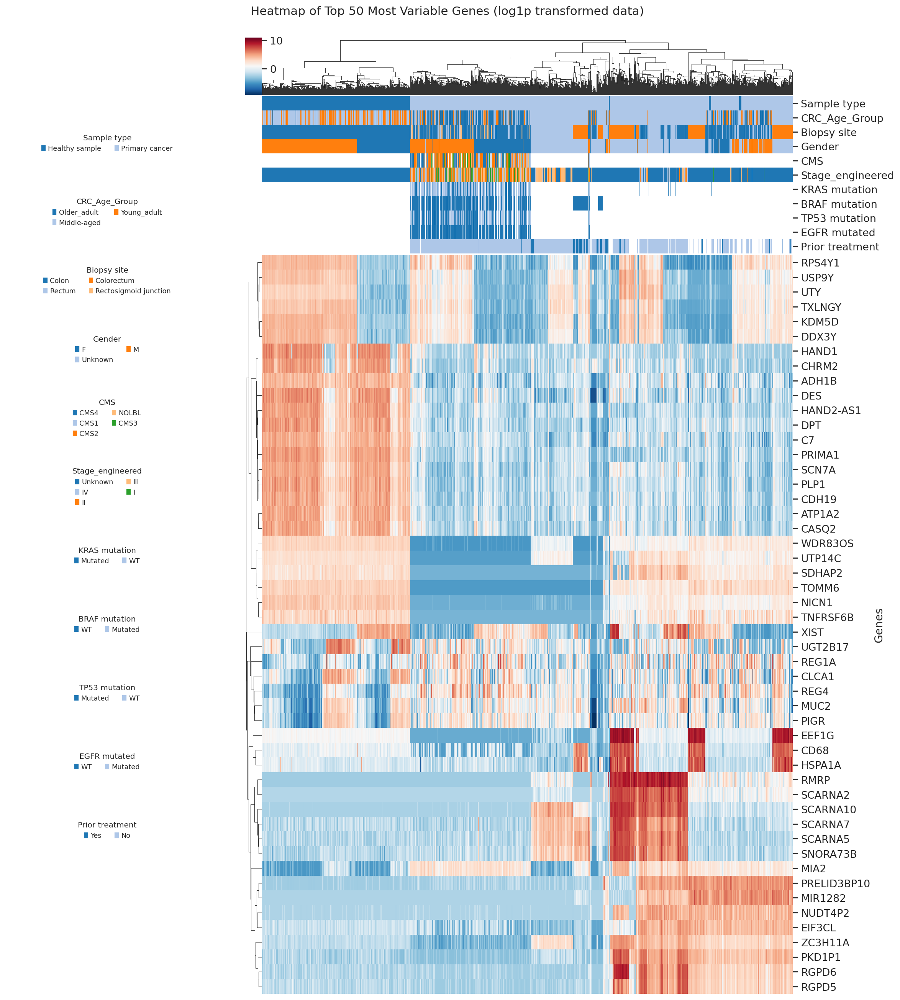

In [8]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.patches import Patch
from scipy.spatial.distance import pdist, squareform

# --- Data Transformation ---
print("Performing log1p transformation on expression data for visualization...")
log_expr_df = np.log1p(gene_expression_df)

# --- Helper Function & Annotation Setup ---
def map_categories_to_colors(metadata: pd.DataFrame, annotation_cols: list) -> tuple[pd.DataFrame, dict]:
    """
    Map categorical metadata columns to color tuples for seaborn annotation bars,
    and produce a dictionary of mappings for legend construction.
    """
    color_maps = {}
    color_mapped_df = pd.DataFrame(index=metadata.index)
    for col in annotation_cols:
        categories = pd.Index(metadata[col].dropna().unique())
        # use tab20 for up to 20 categories, otherwise hls
        if len(categories) <= 20:
            palette = sns.color_palette("tab20", n_colors=len(categories))
        else:
            palette = sns.color_palette("hls", len(categories))
        cmap = dict(zip(categories, palette))
        color_maps[col] = cmap
        color_mapped_df[col] = metadata[col].map(cmap)
    return color_mapped_df, color_maps

annotation_vars = [
    'Sample type','CRC_Age_Group','Biopsy site','Gender','CMS','Stage_engineered',
    'KRAS mutation','BRAF mutation','TP53 mutation','EGFR mutated','Prior treatment'
]

print("Generating color annotations and mappings for metadata...")
side_colors, color_maps = map_categories_to_colors(processed_clinical_df, annotation_vars)


# --- Corrected legend helper: multiple legends added as artists ---
def add_left_grouped_legends(fig, color_mappings, ax_rect=[0.01, 0.56, 0.22, 0.42],
                             max_cols=3, fontsize=8, title_fontsize=9, items_per_col=6):
    """
    Create a single axes on the left-top in figure coords, then add one separate legend
    per variable into that axes using add_artist so legends are not overwritten.
    ax_rect is [left, bottom, width, height] in figure coordinates.
    """
    legend_ax = fig.add_axes(ax_rect)
    legend_ax.axis("off")
    n_vars = len(color_mappings)
    if n_vars == 0:
        return

    # allocate vertical positions within legend_ax in axis coords
    top = 0.98
    bottom = 0.02
    total_height = max(0.3, top - bottom)  # avoid too small
    step = total_height / n_vars

    for i, (var_name, cmap) in enumerate(color_mappings.items()):
        n_items = len(cmap)
        # decide columns so that each column has at most items_per_col items
        ncol = min(max_cols, max(1, int(np.ceil(n_items / items_per_col))))
        handles = [Patch(facecolor=color, label=str(label)) for label, color in cmap.items()]

        # compute anchor in axis coordinates
        y_anchor = top - (i * step)
        # small left margin inside legend_ax
        bbox = (0.01, y_anchor)

        # create legend and add as artist so it does not replace previous legends
        legend = legend_ax.legend(
            handles=handles,
            title=var_name,
            loc="upper left",
            bbox_to_anchor=bbox,
            bbox_transform=legend_ax.transAxes,
            fontsize=fontsize,
            title_fontsize=title_fontsize,
            frameon=False,
            ncol=ncol,
            handlelength=0.8,
            handleheight=0.8,
            columnspacing=0.6,
            labelspacing=0.2
        )
        legend_ax.add_artist(legend)

        # left-align legend texts for neat columns
        for text in legend.get_texts():
            text.set_ha("left")


def plot_sample_distance_heatmap(expr_df: pd.DataFrame,
                                 row_side_colors: pd.DataFrame,
                                 color_mappings: dict,
                                 title: str):
    print("Generating Sample-to-Sample Distance Heatmap...")
    expr_df_clean = expr_df.replace([np.inf, -np.inf], np.nan).dropna(axis=0, how='any')
    sample_dists = pdist(expr_df_clean, metric='euclidean')
    sample_dist_matrix = pd.DataFrame(
        squareform(sample_dists),
        index=expr_df_clean.index,
        columns=expr_df_clean.index
    )

    g = sns.clustermap(
        sample_dist_matrix,
        cmap="Blues_r",
        row_colors=row_side_colors.loc[sample_dist_matrix.index],
        col_colors=row_side_colors.loc[sample_dist_matrix.index],
        xticklabels=False,
        yticklabels=False,
        figsize=(15, 11),                    # a bit wider to compensate for legend margin
        dendrogram_ratio=(0.08, 0.08),       # smaller dendrograms
        colors_ratio=(0.015, 0.015),         # thinner annotation bars
        cbar_kws={"shrink": 0.35}
    )

    g.figure.suptitle(title, fontsize=14, y=1.02)

    # Make space on the left for legends
    g.figure.subplots_adjust(left=0.28)

    # Place each legend outside heatmap
    for i, (var_name, cmap) in enumerate(color_mappings.items()):
        handles = [Patch(facecolor=color, label=str(label)) for label, color in cmap.items()]
        leg_ax = g.figure.add_axes([0.02, 0.9 - (i * 0.055), 0.22, 0.05])  # outside margin
        leg_ax.axis("off")
        leg_ax.legend(
            handles=handles,
            title=var_name,
            loc="center",
            frameon=False,
            fontsize=8,
            title_fontsize=9,
            ncol=2,
            handlelength=0.8,
            handleheight=0.8,
            columnspacing=0.6,
            labelspacing=0.2
        )

    out = "figures/sample_distance_heatmap_legends_outside.png"
    plt.savefig(out, dpi=300, bbox_inches="tight")
    print(f"Saved sample distance heatmap to {out}")
    plt.show()


def plot_variable_genes_heatmap(expr_df: pd.DataFrame, col_side_colors: pd.DataFrame, color_mappings: dict, num_genes: int, title: str):
    print(f"Generating heatmap for top {num_genes} most variable genes...")
    var_series = expr_df.var(axis=0, skipna=True)
    top_genes = var_series.nlargest(num_genes).index
    sub = expr_df.loc[:, top_genes].copy()

    sub = sub.replace([np.inf, -np.inf], np.nan)
    sub = sub.dropna(axis=1, how='all').dropna(axis=0, how='any')
    if sub.shape[1] == 0 or sub.shape[0] == 0:
        raise ValueError("No finite data available after cleaning.")

    # Center genes (subtract gene mean across samples), then transpose
    gene_means = sub.mean(axis=0)
    centered = (sub - gene_means).T

    fig_height = max(16, centered.shape[0] * 0.03)
    g = sns.clustermap(
        centered,
        cmap="RdBu_r",
        col_colors=col_side_colors.loc[centered.columns],
        yticklabels=True,
        xticklabels=False,
        figsize=(15, fig_height),            # slightly wider
        dendrogram_ratio=(0.03, 0.06),       # smaller dendrograms
        cbar_kws={"shrink": 0.3},
        colors_ratio=(0.015, 0.015)          # thinner annotation bars
    )

    g.figure.suptitle(title, fontsize=14, y=1.02)
    g.ax_heatmap.set_ylabel("Genes")

    # Make room on the left for legends
    g.figure.subplots_adjust(left=0.28)        # pushes heatmap right to leave space

    # Add legends outside heatmap area
    for i, (name, cmap) in enumerate(color_mappings.items()):
        handles = [plt.matplotlib.patches.Patch(color=col, label=lab) for lab, col in cmap.items()]
        leg_ax = g.figure.add_axes([0.02, 0.85 - (i * 0.07), 0.22, 0.06])  # outside space
        leg_ax.axis("off")
        leg_ax.legend(
            handles=handles,
            title=name,
            loc="center",
            frameon=False,
            fontsize=8,
            title_fontsize=9,
            ncol=2
        )

    out = "figures/variable_genes_heatmap_legends_outside.png"
    plt.savefig(out, dpi=300, bbox_inches="tight")
    print(f"Saved variable genes heatmap to {out}")
    plt.show()


# --- Call the Visualization Functions ---
print("\n--- Calling Visualization Functions ---")
plot_sample_distance_heatmap(
    expr_df=log_expr_df,
    row_side_colors=side_colors,
    color_mappings=color_maps,
    title="Sample-to-Sample Distance Matrix (log1p transformed data)"
)

plot_variable_genes_heatmap(
    expr_df=log_expr_df,
    col_side_colors=side_colors,
    color_mappings=color_maps,
    num_genes=50,
    title="Heatmap of Top 50 Most Variable Genes (log1p transformed data)"
)


### 3. Unsupervised Clustering & Visualization

- Perform unsupervised clustering using the Leiden algorithm on batch-corrected data.  
- Visualize clusters over the UMAP andvisualize the key clinical information.
 
Back to [Table of Contents](#table-of-contents)

---


--- 2.2: Performing UMAP and Leiden Clustering on FILTERED Data ---
Assigned FILTERED clinical data to AnnData object.
Identifying highly variable genes using flavor='seurat'...
Running PCA on the AnnData object...
Plotting PCA variance ratio...


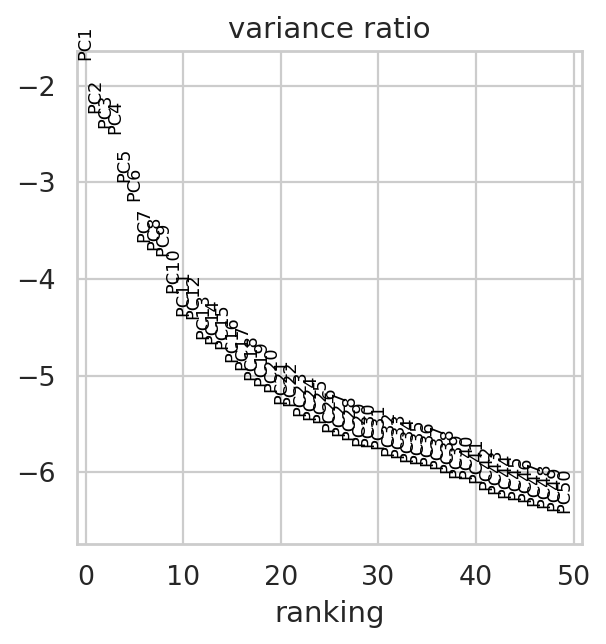

In [9]:
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
import plotly.express as px
import numpy as np
import pandas as pd

# --- 2.2 Unsupervised Clustering on FILTERED Data ---
print("\n--- 2.2: Performing UMAP and Leiden Clustering on FILTERED Data ---")

# Create an AnnData object from the FILTERED dataframes
adata = sc.AnnData(gene_expression_df)
adata.obs = processed_clinical_df.loc[adata.obs.index]
print("Assigned FILTERED clinical data to AnnData object.")

# --- Standard Scanpy Preprocessing Pipeline ---
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)
print("Identifying highly variable genes using flavor='seurat'...")
sc.pp.highly_variable_genes(adata,   n_top_genes=5000, flavor='seurat')
adata = adata[:, adata.var.highly_variable]
sc.pp.scale(adata, max_value=10)

# --- Run PCA on adata and THEN plot variance ratio ---
print("Running PCA on the AnnData object...")
sc.tl.pca(adata, n_comps=50)
print("Plotting PCA variance ratio...")
sc.pl.pca_variance_ratio(adata, log=True, n_pcs=50, save="_variance_ratio.png", show=True)



Finding neighbors and computing UMAP on filtered data...
Calculating Leiden clusters for resolutions: [0.1]...

>>> Visualizing for Leiden Resolution: 0.1 <<<


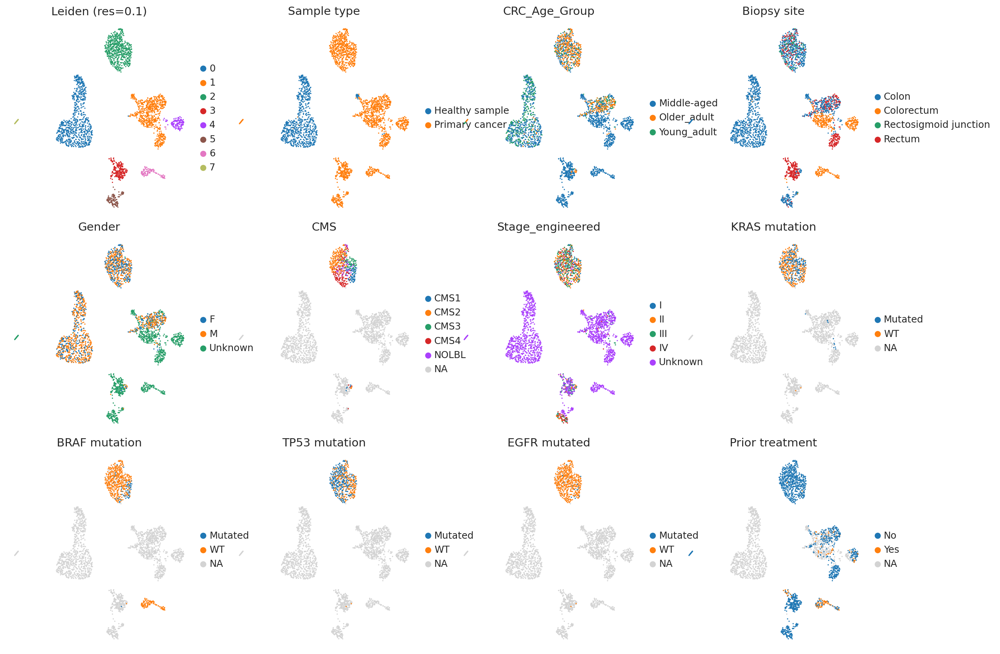


--- All 12-panel UMAP visualizations have been generated and saved. ---


In [10]:
# --- Graph-Based Clustering and Visualization ---
print("\nFinding neighbors and computing UMAP on filtered data...")
# Chosen n neighbors is approximately the square root of the sample size. sq root(2700) = 52
sc.pp.neighbors(adata, n_neighbors=52, n_pcs=20, random_state=42)
sc.tl.umap(adata, min_dist=0.7, spread=1.0, random_state=42)

# --- Run Leiden Clustering ---
# This step ensures the cluster data is present in the adata object before plotting.
# resolutions_to_plot = [0.1, 0.2, 0.3] In my initial runs of the analysis, I have tested multiple resolutions to see the impact on clustering.
resolutions_to_plot = [0.1] # It became evident that, resolution 0.1 is well separating healthy samples from others in this dataset after visual inspection
print(f"Calculating Leiden clusters for resolutions: {resolutions_to_plot}...")
for res in resolutions_to_plot:
    sc.tl.leiden(adata, resolution=res, key_added=f"leiden_res_{res}")

# --- Define the 10 Most Informative Clinical Variables for Visualization ---
# We select a mix of core, clinical, and molecular features.
annotation_vars = ['Sample type',
                   'CRC_Age_Group',
                   'Biopsy site',
                   'Gender',
                   'CMS',
                   'Stage_engineered',
                   'KRAS mutation',
                   'BRAF mutation',
                   'TP53 mutation',
                   'EGFR mutated',
                   'Prior treatment']

# --- Visualization Loop with 12-Panel Layout ---
for res in resolutions_to_plot:
    leiden_key = f"leiden_res_{res}"
    print(f"\n>>> Visualizing for Leiden Resolution: {res} <<<")
    
    # Check if the cluster key exists
    if leiden_key not in adata.obs.columns:
        print(f"Error: The key '{leiden_key}' was not found in adata.obs. Skipping plot.")
        continue
        
    # Combine the cluster key with the 11 clinical variables
    vars_to_plot = [leiden_key] + annotation_vars

    # Create descriptive titles for each of the 12 plots
    plot_titles = [
        f'Leiden (res={res})',
        'Sample type',
        'CRC_Age_Group',
        'Biopsy site',
        'Gender',
        'CMS',
        'Stage_engineered',
        'KRAS mutation',
        'BRAF mutation',
        'TP53 mutation',
        'EGFR mutated',
        'Prior treatment'
    ]

    # Use scanpy's plotting function with a 4x3 layout
    sc.pl.umap( 
        adata,
        color=vars_to_plot,
        # Arrange plots in a 4x3 grid
        ncols=4,
        # Use a perceptually uniform color map for clusters
        palette=sc.pl.palettes.default_20,
        # Place legend in the right margin for clarity
        legend_loc='right margin',
        legend_fontsize='small',
        frameon=False,
        # Adjust space between plots
        wspace=0.1, 
        hspace=0.1,
        title=plot_titles,
        show=True,
        size=8,
        save=f"_UMAP_Resolution_{res}_12_Panel_Annotations.png"
    )
    plt.show()

print("\n--- All 12-panel UMAP visualizations have been generated and saved. ---")

#### Feature plots

**Above figure** is the summarization of the all significantly enriched GSEA results for the selected 4 databases.

Back to [Table of Contents](#table-of-contents)

---

In [ ]:
# --- 2.3 Finalize Cluster Selection ---
print("\n--- 2.3: Finalizing Cluster Selection ---")
chosen_resolution = 0.1  # Selected resolution 0.1 after visual inspection
final_cluster_key = f"leiden_res_{chosen_resolution}"
adata.obs['leiden_clusters'] = adata.obs[final_cluster_key].astype('category')
processed_clinical_df['leiden_cluster'] = adata.obs['leiden_clusters']
print(f"Final cluster identity set using resolution {chosen_resolution}.")
print("The 'processed_clinical_df' dataframe and 'adata' object are now ready for next phase.")


--- 2.3: Finalizing Cluster Selection ---
Final cluster identity set using resolution 0.1.
The 'processed_clinical_df' dataframe and 'adata' object are now ready for next phase.


Chi Square test script

In [12]:
import pandas as pd
import numpy as np
from scipy.stats import chi2_contingency
from statsmodels.stats.multitest import multipletests
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# --- Comprehensive Chi-Squared Association Testing ---
print("\n--- Comprehensive Chi-Squared Association Testing ---")

cluster_col = 'leiden_cluster'

# --- Dynamically select all suitable categorical columns for testing ---
clinical_vars_to_test = []
for col in processed_clinical_df.columns:
    if processed_clinical_df[col].dtype.name in ['category', 'object', 'bool']:
        if 1 < processed_clinical_df[col].nunique() < 50 and col != cluster_col:
            clinical_vars_to_test.append(col)

# --- Perform Chi-Squared Test for each Variable ---
results = []
for var in clinical_vars_to_test:
    test_df = processed_clinical_df[[cluster_col, var]].dropna()
    if test_df.empty or test_df[cluster_col].nunique() < 2 or test_df[var].nunique() < 2:
        continue
    contingency_table = pd.crosstab(test_df[cluster_col], test_df[var])
    try:
        chi2, p_val, dof, expected = chi2_contingency(contingency_table)
        results.append({'Clinical Variable': var, 'p-value': p_val})
    except ValueError:
        continue

# --- Create and Correct Results DataFrame ---
if results:
    results_df = pd.DataFrame(results).sort_values('p-value')
    reject, pvals_corrected, _, _ = multipletests(results_df['p-value'], alpha=0.05, method='fdr_bh')
    results_df['Adjusted p-value (FDR)'] = pvals_corrected
    results_df['Is Significant (FDR<0.05)'] = reject

    print("\n--- Statistical Association Results ---")
    display(results_df)

    # --- Visualize ALL Significant Associations ---
    significant_results = results_df[results_df['Is Significant (FDR<0.05)']]

    if not significant_results.empty:
        all_significant_vars = significant_results['Clinical Variable'].tolist()
        num_plots = len(all_significant_vars)

        print(f"\n--- Visualizing all {num_plots} significant associations ---")

        # Define layout
        ncols = 7
        nrows = int(np.ceil(num_plots / ncols))

        fig = make_subplots(
            rows=nrows,
            cols=ncols,
            subplot_titles=all_significant_vars,
            vertical_spacing=0.12,
            horizontal_spacing=0.04
        )

        # Keep a stable list of all cluster labels so every subplot has same Y axis ordering
        all_clusters = list(processed_clinical_df[cluster_col].astype(str).unique())
        # Optionally sort clusters if desired:
        # all_clusters = sorted(all_clusters, key=lambda x: int(x) if str(x).isdigit() else x)

        for i, var_to_plot in enumerate(all_significant_vars):
            row = i // ncols + 1
            col = i % ncols + 1
            axis_idx = i + 1  # axis numbering for xref/yref: x1/y1, x2/y2, ...

            # Use only rows that have non-missing cluster values, but reindex so all clusters appear
            ctab = pd.crosstab(
                processed_clinical_df[cluster_col].astype(str),
                processed_clinical_df[var_to_plot].astype(str),
                dropna=False
            )

            # Ensure every cluster is present in the index (fill missing with zeros)
            ctab = ctab.reindex(index=all_clusters, fill_value=0)

            # Normalize per-row (cluster) to percentages. Handle rows with sum 0 safely.
            row_sums = ctab.sum(axis=1).replace({0: np.nan})
            ctab_pct = ctab.div(row_sums, axis=0).fillna(0) * 100

            x_labels = list(ctab_pct.columns.astype(str))
            y_labels = list(ctab_pct.index.astype(str))
            z_values = ctab_pct.values  # shape: (n_rows, n_cols)

            # Numeric grid coordinates
            x_pos = np.arange(len(x_labels))
            y_pos = np.arange(len(y_labels))

            # Add heatmap using numeric coordinates so annotations align to integer indices
            heatmap_trace = go.Heatmap(
                z=z_values,
                x=x_pos,
                y=y_pos,
                colorscale='Viridis',
                zmin=0,
                zmax=100,
                showscale=False
            )
            fig.add_trace(heatmap_trace, row=row, col=col)

            # Set tick labels for this subplot's axes (row/col ensures we target correct subplot axis)
            fig.update_xaxes(
                tickmode='array',
                tickvals=x_pos.tolist(),
                ticktext=x_labels,
                row=row, col=col,
                tickangle=45,
                automargin=True
            )
            fig.update_yaxes(
                tickmode='array',
                tickvals=y_pos.tolist(),
                ticktext=y_labels,
                row=row, col=col,
                automargin=True
            )

            # Add annotations anchored to the subplot's axis (xref/yref use the axis number)
            for r_idx in range(z_values.shape[0]):
                for c_idx in range(z_values.shape[1]):
                    val = z_values[r_idx, c_idx]
                    txt = f'{val:.1f}%' if not np.isnan(val) else ''
                    # choose font color depending on background intensity
                    font_color = "white" if val < 50 else "black"
                    fig.add_annotation(
                        x=c_idx, y=r_idx,
                        xref=f'x{axis_idx}', yref=f'y{axis_idx}',
                        text=txt,
                        showarrow=False,
                        font=dict(color=font_color, size=10),
                        xanchor='center',
                        yanchor='middle'
                    )

        # Update layout
        fig.update_layout(
            height=380 * nrows,
            width=1400,
            title_text="<b>All Significant Associations Between Clinical Variables and Leiden Clusters</b>",
            title_x=0.5,
            margin=dict(l=60, r=20, t=80, b=60)
        )
        fig.show()
else:
    print("\nNo valid statistical tests could be completed.")



--- Comprehensive Chi-Squared Association Testing ---

--- Statistical Association Results ---


,Clinical Variable,p-value,Adjusted p-value (FDR),Is Significant (FDR<0.05)
25,MSI_status_engineered,0.000000e+00,0.000000e+00,True
2,Biopsy site,0.000000e+00,0.000000e+00,True
15,Primary site,0.000000e+00,0.000000e+00,True
24,Therapy type,0.000000e+00,0.000000e+00,True
6,Donor type,0.000000e+00,0.000000e+00,True
9,Histological subtype,0.000000e+00,0.000000e+00,True
19,Gender,0.000000e+00,0.000000e+00,True
26,Stage_engineered,0.000000e+00,0.000000e+00,True
18,Sample type,0.000000e+00,0.000000e+00,True
27,CRC_Age_Group,7.800059e-257,2.184016e-256,True



--- Visualizing all 21 significant associations ---


#### Chi-Square Test

Above I have investigated the significance of the association of the categorical variables of the clinical data of the cohort with the determined unsupervised clusters.

I was expecting the see more clear association between different cluster

**The goal** was finding a m is the summarization of the all significantly enriched GSEA results for the selected 4 databases.

Back to [Table of Contents](#table-of-contents)

---

---

### 4. Differential Expression (DE) Analysis

- Perform a robust, cluster-aware DE analysis, comparing each identified CRC cluster against healthy donor samples using **DESeq2**.

- At first I had problems for covariates on parametric test, came up with a hybrid approach of if parametric test fails, try non-parametric DE test with Wilcox
 
- Identify differentially expressed genes (DEGs) and visualize results with volcano plots.  

- Generate top DEGs heatmap.

Back to [Table of Contents](#table-of-contents)

DE tests of the other clusters over Healthy Cluster/s

In [13]:
import pandas as pd
import numpy as np
import os
from multiprocessing import Pool, cpu_count

# Pydeseq2 and statsmodels are required
try:
    from pydeseq2.dds import DeseqDataSet
    from pydeseq2.ds import DeseqStats
except ImportError:
    print("Please install pydeseq2: pip install pydeseq2")
    raise

from scipy.stats import mannwhitneyu
from statsmodels.stats.multitest import multipletests

print("\n--- Implementing Hybrid DE Strategy (DESeq2 'mean' fit with Wilcoxon Fallback) ---")

# --- 1. Setup and Configuration ---
output_dir = "Hybrid_DE_Results"
os.makedirs(output_dir, exist_ok=True)
print(f"Results will be saved in the '{output_dir}/' directory.")

#########################################################################################
# --- Define a cluster (or Metacluster of comparison) and Disease Clusters ---
healthy_cluster_ids = [0] # As an example, user can define multiple clusters as i.e. ['2', '3']
#########################################################################################

# Load the gene expression and clinical data

expression_df = gene_expression_df
clinical_df = processed_clinical_df

try:
    expression_df.shape
    clinical_df.shape
    print("Using pre-loaded 'expression_df' and 'clinical_df'.")
except NameError:
    print("Placeholder dataframes not found, generating mock data for testing...")
    num_samples, num_genes = 40, 1000
    samples = [f"Sample_{i}" for i in range(num_samples)]
    genes = [f"Gene_{j}" for j in range(num_genes)]
    expression_df = pd.DataFrame(np.random.randint(0, 1000, size=(num_genes, num_samples)), index=genes, columns=samples)
    clusters = ['1']*8 + ['2']*8 + ['3']*8 + ['4']*8 + ['5']*8
    np.random.shuffle(clusters)
    clinical_df = pd.DataFrame({
        'leiden_cluster': pd.Categorical(clusters),
        'Gender': np.random.choice(['M', 'F'], size=num_samples),
        'Biopsy site': np.random.choice(['Colon', 'Rectum'], size=num_samples)
    }, index=samples)

max_procs = min(cpu_count(), 12)

# --- Define a cluster (or Metacluster of comparison) and Disease Clusters ---
healthy_cluster_ids = ['0'] # As an example user can define multiple clusters as ['2', '3']
all_leiden_clusters = clinical_df['leiden_cluster'].cat.categories.tolist()
disease_clusters_to_test = [c for c in all_leiden_clusters if c not in healthy_cluster_ids]
print(f"\nDefining a Healthy Metacluster from clusters: {healthy_cluster_ids}")
healthy_metacluster_samples_df = clinical_df[clinical_df['leiden_cluster'].isin(healthy_cluster_ids)]
print(f"Created Healthy Metacluster from {len(healthy_metacluster_samples_df)} samples.")
print(f"Identifying Disease clusters for comparison: {disease_clusters_to_test}")

#################################################################################
# --- Define Covariates for DESeq2 ---
# Note: 'Biopsy site' is excluded because all healthy samples are from 'Colon',
# which causes perfect confounding with the 'condition' variable in this subset.
# This results in a rank-deficient design matrix in DESeq2. 
# Current covariates: 'Gender' and 'CRC_Age_Group'.
#################################################################################
potential_covariates = ['Gender', 'CRC_Age_Group']
all_de_results = {}

# --- 2. Helper Function for Parallel Processing ---
def _mw_for_gene(args):
    gene, grp1_vals, grp2_vals = args
    try:
        lfc = np.mean(grp1_vals) - np.mean(grp2_vals)
        if np.all(grp1_vals == grp1_vals[0]) and np.all(grp2_vals == grp2_vals[0]) and grp1_vals[0] == grp2_vals[0]:
            return gene, lfc, 1.0
        stat, p = mannwhitneyu(grp1_vals, grp2_vals, alternative='two-sided', nan_policy='omit')
        return gene, lfc, p
    except (ValueError, Exception):
        return gene, 0.0, 1.0

# --- 3. Main Hybrid DE Analysis Loop ---
for cluster_id in disease_clusters_to_test:
    analysis_method = "Failed"
    results_df = pd.DataFrame()

    try:
        print(f"\n>>> Plan A: Attempting DESeq2 with 'mean' fit for Cluster '{cluster_id}' vs. Healthy Metacluster <<<")

        # A: Assemble data
        cluster_samples_df = clinical_df[clinical_df['leiden_cluster'] == cluster_id]
        comparison_samples_df = pd.concat([cluster_samples_df, healthy_metacluster_samples_df])
        metadata = comparison_samples_df.copy()

        # B: Handle metadata and define condition
        metadata.dropna(subset=potential_covariates, inplace=True)
        disease_condition_name = f'Disease_Cluster_{cluster_id}'
        healthy_condition_name = 'Healthy_Metacluster'
        metadata['condition'] = np.where(metadata['leiden_cluster'].isin(healthy_cluster_ids), healthy_condition_name, disease_condition_name)
        metadata['condition'] = pd.Categorical(values=metadata['condition'], categories=[healthy_condition_name, disease_condition_name])

        if len(metadata['condition'].unique()) < 2 or metadata['condition'].value_counts().min() < 2:
            raise ValueError("Fewer than 2 groups or fewer than 2 samples in a group after filtering.")

        # C: Build design factors list
        valid_covariates = [cov for cov in potential_covariates if cov in metadata.columns and metadata[cov].nunique() > 1]
        design_factors_list = valid_covariates + ['condition']
        print(f"Using design factors: {design_factors_list} on {len(metadata)} samples.")

        # D: Prepare counts matrix
        if set(metadata.index).issubset(set(expression_df.columns)):
            counts_df = expression_df.loc[:, metadata.index].T
        else:
            counts_df = expression_df.loc[metadata.index]
        counts_df = counts_df.astype(int)

        # E: Run DESeq2
        dds = DeseqDataSet(counts=counts_df, metadata=metadata, design_factors=design_factors_list, fit_type='mean')
        dds.deseq2()
        stat_res = DeseqStats(dds, contrast=["condition", disease_condition_name, healthy_condition_name], n_cpus=max_procs)
        stat_res.summary()

        # <<< FIX: Implementing robust, version-agnostic LFC shrinkage logic.
        print("Applying LFC shrinkage...")
        try:
            # Check for various possible method names for LFC shrinkage
            if hasattr(stat_res, 'lfc_shrink'):
                # Pass the contrast list directly, which is more robust than using coeff names
                stat_res.lfc_shrink(contrast=["condition", disease_condition_name, healthy_condition_name])
            elif hasattr(stat_res, 'lfcShrink'):
                stat_res.lfcShrink(contrast=["condition", disease_condition_name, healthy_condition_name])
            else:
                # If a dedicated shrink method is not on the stat_res object, get the unshrunken results
                results_df = stat_res.results_df.copy()
                # And attempt a manual pseudocount shrinkage as a last resort
                if 'baseMean' in results_df.columns and 'log2FoldChange' in results_df.columns:
                    print("Warning: Built-in LFC shrinkage method not found. Applying manual pseudocount shrinkage.")
                    prior = np.median(results_df['baseMean'].dropna().values)
                    shrink_factor = results_df['baseMean'] / (results_df['baseMean'] + prior)
                    results_df['log2FoldChange'] = results_df['log2FoldChange'] * shrink_factor
                
            results_df = stat_res.results_df # The result is updated in-place on the stat_res object
            print("Applied built-in LFC shrinkage.")
            
        except Exception as shrink_e:
            print(f"Warning: LFC shrinkage attempt raised an error ({shrink_e}). Using raw DESeq2 results.")
            results_df = stat_res.results_df

        analysis_method = "DESeq2_mean_fit"
        print(f"Successfully ran DESeq2 with 'mean' fit for Cluster '{cluster_id}'.")

    except Exception as e:
        # --- Plan B: Wilcoxon Fallback ---
        print(f"\nINFO: DESeq2 failed for Cluster '{cluster_id}' (Reason: {e}).")
        print(">>> Plan B: Falling back to Mann-Whitney U test. <<<")

        try:
            if set(clinical_df.index).issubset(set(expression_df.columns)):
                full_counts = expression_df.loc[:, clinical_df.index].T
            else:
                full_counts = expression_df.loc[clinical_df.index]

            lib_sizes = full_counts.sum(axis=1); cpm = full_counts.div(lib_sizes, axis=0) * 1e6
            log2cpm = np.log2(cpm + 1)
            cluster_sample_ids = clinical_df[clinical_df['leiden_cluster'] == cluster_id].index
            healthy_sample_ids = healthy_metacluster_samples_df.index

            if len(cluster_sample_ids) < 2 or len(healthy_sample_ids) < 2: raise ValueError("Not enough samples for a rank-sum test.")

            genes = log2cpm.columns.tolist()
            args_iter = [(g, log2cpm.loc[cluster_sample_ids, g].values, log2cpm.loc[healthy_sample_ids, g].values) for g in genes]
            
            with Pool(processes=max_procs) as pool: results_list = pool.map(_mw_for_gene, args_iter)
            results_df = pd.DataFrame(results_list, columns=['gene', 'log2FoldChange', 'pvalue']).set_index('gene')

            print("Applying manual LFC shrinkage to Wilcoxon results...")
            comparison_samples = cluster_sample_ids.union(healthy_sample_ids)
            base_means = full_counts.loc[comparison_samples].mean()
            prior = base_means.median()
            shrink_factor = base_means / (base_means + prior)
            results_df['log2FoldChange'] = results_df['log2FoldChange'] * shrink_factor
            results_df['baseMean'] = base_means
            analysis_method = "Fallback_Wilcoxon"

        except Exception as fallback_e:
            print(f"CRITICAL ERROR: Wilcoxon fallback also failed for Cluster '{cluster_id}': {fallback_e}")
            continue

    # --- 4. Post-analysis Steps & Save Results ---
    if not results_df.empty:
        results_df.dropna(subset=['pvalue'], inplace=True)
        results_df['padj'] = multipletests(results_df['pvalue'], method='bonferroni')[1]
        
        results_df.sort_values('padj', inplace=True)
        output_path = os.path.join(output_dir, f"{analysis_method}_Cluster_{cluster_id}_vs_Healthy.csv")
        results_df.to_csv(output_path)
        all_de_results[f"Cluster_{cluster_id}"] = results_df

        significant_degs = results_df[(results_df['padj'] < 0.05) & (results_df['log2FoldChange'].abs() > 1.5)]
        print(f"Analysis using '{analysis_method}' complete. Results saved to: {output_path}")
        print(f"Found {len(significant_degs)} significant DEGs (Bonferroni p-adj < 0.05 and |shrunken log2FC| > 1.5).")

print("\n--- All Hybrid DE Strategy analyses are complete. ---")


--- Implementing Hybrid DE Strategy (DESeq2 'mean' fit with Wilcoxon Fallback) ---
Results will be saved in the 'Hybrid_DE_Results/' directory.
Using pre-loaded 'expression_df' and 'clinical_df'.

Defining a Healthy Metacluster from clusters: ['0']
Created Healthy Metacluster from 778 samples.
Identifying Disease clusters for comparison: ['1', '2', '3', '4', '5', '6', '7']

>>> Plan A: Attempting DESeq2 with 'mean' fit for Cluster '1' vs. Healthy Metacluster <<<
Using design factors: ['Gender', 'CRC_Age_Group', 'condition'] on 1502 samples.


Fitting size factors...


Using None as control genes, passed at DeseqDataSet initialization


... done in 0.46 seconds.

Fitting dispersions...
... done in 4.27 seconds.

Fitting dispersion trend curve...
... done in 0.00 seconds.

Fitting MAP dispersions...
... done in 4.89 seconds.

Fitting LFCs...
... done in 3.34 seconds.

Calculating cook's distance...
... done in 2.11 seconds.

Replacing 984 outlier genes.

Fitting dispersions...
... done in 0.26 seconds.

Fitting MAP dispersions...
... done in 0.25 seconds.

Fitting LFCs...
... done in 0.32 seconds.

Running Wald tests...
... done in 2.27 seconds.



Log2 fold change & Wald test p-value: condition Disease_Cluster_1 vs Healthy_Metacluster
                baseMean  log2FoldChange     lfcSE       stat         pvalue  \
RMRP        17986.186895       21.279163  0.685852  31.025871  2.414465e-211   
EEF1G       87515.474252        3.534668  0.218607  16.169014   8.342249e-59   
XIST         5960.669199       -0.471044  0.195909  -2.404398   1.619913e-02   
TOMM6        2648.395391        0.901040  0.062793  14.349395   1.074706e-46   
SCARNA10      980.385456       16.346581  0.592428  27.592520  1.368168e-167   
...                  ...             ...       ...        ...            ...   
MIR3170         1.008728        2.226807  0.460395   4.836732   1.319911e-06   
LINC01532       0.655994       -0.856617  0.329257  -2.601664   9.277259e-03   
ARL5C           0.765319       -0.087320  0.227787  -0.383340   7.014674e-01   
MIR634          0.558567        2.225817  0.399002   5.578462   2.426549e-08   
ELOVL2-AS1      0.556099       

Fitting size factors...


Using None as control genes, passed at DeseqDataSet initialization


... done in 0.62 seconds.

Fitting dispersions...
... done in 4.33 seconds.

Fitting dispersion trend curve...
... done in 0.00 seconds.

Fitting MAP dispersions...
... done in 5.36 seconds.

Fitting LFCs...
... done in 3.23 seconds.

Calculating cook's distance...
... done in 2.07 seconds.

Replacing 1096 outlier genes.

Fitting dispersions...
... done in 0.29 seconds.

Fitting MAP dispersions...
... done in 0.28 seconds.

Fitting LFCs...
... done in 0.33 seconds.

Running Wald tests...
... done in 2.27 seconds.



Log2 fold change & Wald test p-value: condition Disease_Cluster_2 vs Healthy_Metacluster
               baseMean  log2FoldChange     lfcSE       stat        pvalue  \
RMRP           0.038361        0.648701  3.758130   0.172613  8.629558e-01   
EEF1G         70.169108       -8.374470  0.122362 -68.439980  0.000000e+00   
XIST        3326.047347       -1.506746  0.103379 -14.574904  4.056944e-48   
TOMM6       1372.200071      -13.332789  0.136442 -97.717536  0.000000e+00   
SCARNA10       0.089992        0.967286  0.589182   1.641744  1.006431e-01   
...                 ...             ...       ...        ...           ...   
MIR3170        0.058356        0.973215  0.752418   1.293450  1.958554e-01   
LINC01532      0.897962       -1.607085  0.249972  -6.429050  1.284038e-10   
ARL5C          0.696637       -1.322036  0.193345  -6.837698  8.047566e-12   
MIR634         0.062953        0.671634  0.701980   0.956771  3.386827e-01   
ELOVL2-AS1     0.663889       -0.336212  0.218539  -1

Fitting size factors...


Using None as control genes, passed at DeseqDataSet initialization


... done in 0.34 seconds.

Fitting dispersions...
... done in 4.30 seconds.

Fitting dispersion trend curve...
... done in 0.00 seconds.

Fitting MAP dispersions...
... done in 4.98 seconds.

Fitting LFCs...
... done in 3.72 seconds.

Calculating cook's distance...
... done in 1.52 seconds.

Replacing 915 outlier genes.

Fitting dispersions...
... done in 0.24 seconds.

Fitting MAP dispersions...
... done in 0.24 seconds.

Fitting LFCs...
... done in 0.63 seconds.

Running Wald tests...
... done in 2.39 seconds.



Log2 fold change & Wald test p-value: condition Disease_Cluster_3 vs Healthy_Metacluster
               baseMean  log2FoldChange      lfcSE       stat         pvalue  \
RMRP         199.744711       25.714528  13.965343   1.841310   6.557611e-02   
EEF1G        506.024602        7.090764   0.356400  19.895495   4.451908e-88   
XIST        7369.756569        2.858553   0.515561   5.544553   2.947064e-08   
TOMM6       1541.052158       -9.860115   0.291285 -33.850455  3.573669e-251   
SCARNA10     906.868156        7.043906   1.688171   4.172507   3.012661e-05   
...                 ...             ...        ...        ...            ...   
MIR3170        1.991023        6.185994   0.746864   8.282629   1.204858e-16   
LINC01532      4.365430        2.177946   1.052212   2.069874   3.846414e-02   
ARL5C          2.990423        2.364136   0.688472   3.433890   5.949862e-04   
MIR634         1.598386        4.496882   0.919734   4.889328   1.011806e-06   
ELOVL2-AS1     3.979916        

Fitting size factors...


Using None as control genes, passed at DeseqDataSet initialization


... done in 0.44 seconds.

Fitting dispersions...
... done in 3.55 seconds.

Fitting dispersion trend curve...
... done in 0.00 seconds.

Fitting MAP dispersions...
... done in 4.58 seconds.

Fitting LFCs...
... done in 2.58 seconds.

Calculating cook's distance...
... done in 1.37 seconds.

Replacing 3069 outlier genes.

Fitting dispersions...
... done in 0.63 seconds.

Fitting MAP dispersions...
... done in 0.63 seconds.

Fitting LFCs...
... done in 0.67 seconds.

Running Wald tests...
... done in 2.17 seconds.



Log2 fold change & Wald test p-value: condition Disease_Cluster_4 vs Healthy_Metacluster
                 baseMean  log2FoldChange      lfcSE       stat        pvalue  \
RMRP         20415.991330       11.819857   1.371720   8.616815  6.884238e-18   
EEF1G       184440.107164       13.491751   0.648377  20.808506  3.624672e-96   
XIST         51329.345978       12.893892   1.698866   7.589706  3.206317e-14   
TOMM6         2711.387876       -0.633123   0.455109  -1.391147  1.641809e-01   
SCARNA10      8602.742737       16.600672   3.423704   4.848746  1.242442e-06   
...                   ...             ...        ...        ...           ...   
MIR3170          0.000688       -0.950182  43.713185  -0.021737  9.826580e-01   
LINC01532        1.242026       -0.908696   4.401026  -0.206474  8.364209e-01   
ARL5C            1.454964       -1.369170   2.399192  -0.570679  5.682169e-01   
MIR634           0.463485        2.289650   7.612149   0.300789  7.635754e-01   
ELOVL2-AS1       0.7

Fitting size factors...


Using None as control genes, passed at DeseqDataSet initialization


... done in 0.45 seconds.

Fitting dispersions...
... done in 3.81 seconds.

Fitting dispersion trend curve...
... done in 0.00 seconds.

Fitting MAP dispersions...
... done in 4.38 seconds.

Fitting LFCs...
... done in 5.10 seconds.

Calculating cook's distance...
... done in 1.36 seconds.

Replacing 1926 outlier genes.

Fitting dispersions...
... done in 0.39 seconds.

Fitting MAP dispersions...
... done in 0.46 seconds.

Fitting LFCs...
... done in 2.22 seconds.

Running Wald tests...
... done in 2.24 seconds.



Log2 fold change & Wald test p-value: condition Disease_Cluster_5 vs Healthy_Metacluster
                baseMean  log2FoldChange      lfcSE       stat        pvalue  \
RMRP        24200.031048        8.033728   0.654951  12.266145  1.376533e-34   
EEF1G         152.303902       -1.197331   0.242202  -4.943515  7.672660e-07   
XIST        31733.489182        2.423778   1.049272   2.309961  2.089033e-02   
TOMM6        2644.608588       -4.219217   0.330435 -12.768681  2.452751e-37   
SCARNA10     5868.852986        8.369934   0.524689  15.952177  2.751357e-57   
...                  ...             ...        ...        ...           ...   
MIR3170         0.025813        0.140178  18.451223   0.007597  9.939384e-01   
LINC01532       1.204154        0.955442   2.690455   0.355123  7.224975e-01   
ARL5C           1.849675        0.309866   1.676143   0.184868  8.533324e-01   
MIR634          1.788083        2.416186   1.613280   1.497686  1.342149e-01   
ELOVL2-AS1      0.717692       

Fitting size factors...


Using None as control genes, passed at DeseqDataSet initialization


... done in 0.34 seconds.

Fitting dispersions...
... done in 3.83 seconds.

Fitting dispersion trend curve...
... done in 0.00 seconds.

Fitting MAP dispersions...
... done in 4.74 seconds.

Fitting LFCs...
... done in 2.99 seconds.

Calculating cook's distance...
... done in 1.42 seconds.

Replacing 2772 outlier genes.

Fitting dispersions...
... done in 0.53 seconds.

Fitting MAP dispersions...
... done in 0.54 seconds.

Fitting LFCs...
... done in 0.84 seconds.

Running Wald tests...
... done in 2.35 seconds.



Log2 fold change & Wald test p-value: condition Disease_Cluster_6 vs Healthy_Metacluster
               baseMean  log2FoldChange      lfcSE       stat        pvalue  \
RMRP        4192.659252        0.227865  43.042680   0.005294  9.957761e-01   
EEF1G        106.227435       -4.108804   0.384302 -10.691613  1.114161e-26   
XIST        5655.148081        8.775839   1.604351   5.470024  4.499743e-08   
TOMM6       2059.051577       -9.699591   0.493543 -19.652992  5.450340e-86   
SCARNA10      73.528568        9.817114   3.811276   2.575807  1.000063e-02   
...                 ...             ...        ...        ...           ...   
MIR3170        1.589843        5.245494   3.499039   1.499124  1.338414e-01   
LINC01532      5.254068        5.462982   4.370599   1.249939  2.113218e-01   
ARL5C         10.238194        4.163556   2.324930   1.790831  7.332043e-02   
MIR634         0.626911        3.465251   5.227429   0.662898  5.073961e-01   
ELOVL2-AS1    30.110808        6.461167   

Fitting size factors...


Using None as control genes, passed at DeseqDataSet initialization


... done in 0.24 seconds.

Fitting dispersions...
... done in 3.50 seconds.

Fitting dispersion trend curve...
... done in 0.00 seconds.

Fitting MAP dispersions...
... done in 4.47 seconds.

Fitting LFCs...
... done in 2.33 seconds.

Calculating cook's distance...
... done in 1.21 seconds.

Replacing 13770 outlier genes.

Fitting dispersions...
... done in 2.35 seconds.

Fitting MAP dispersions...
... done in 3.19 seconds.

Fitting LFCs...
... done in 1.38 seconds.

Running Wald tests...
... done in 2.21 seconds.



Log2 fold change & Wald test p-value: condition Disease_Cluster_7 vs Healthy_Metacluster
               baseMean  log2FoldChange      lfcSE       stat        pvalue  \
RMRP           0.081822       -5.981716  41.738295  -0.143315  8.860416e-01   
EEF1G        157.546560        0.273537   0.408211   0.670088  5.028017e-01   
XIST        5848.010392       -6.007513   1.239554  -4.846511  1.256514e-06   
TOMM6       3014.804397      -11.880786   0.792169 -14.997796  7.589777e-51   
SCARNA10       0.010977        0.040960  27.051236   0.001514  9.987919e-01   
...                 ...             ...        ...        ...           ...   
MIR3170        0.000747        0.003058  41.870811   0.000073  9.999417e-01   
LINC01532      1.507533        0.329462   4.471640   0.073678  9.412665e-01   
ARL5C          1.280313       -2.279148   2.383818  -0.956092  3.390259e-01   
MIR634         0.047470        0.057197  13.505419   0.004235  9.966209e-01   
ELOVL2-AS1     0.897793       -2.270948   

In [14]:
# Generating a Heatmap from the selected significantly, most up/down regulated genes

import os
import math
import numpy as np
import pandas as pd
import scanpy as sc
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import matplotlib as mpl
from sklearn.preprocessing import StandardScaler

# -------------------------
# Tweakable PARAMETERS
# -------------------------
RESULTS_DIR = "Hybrid_DE_Results/"   # folder with DE CSVs
OUTPUT_DIR = "figures"

# Figure sizing heuristics
FIG_BASE_WIDTH = 6.0
FIG_BASE_HEIGHT = 4.0
FIG_WIDTH_PER_SAMPLE = 0.02
FIG_HEIGHT_PER_GENE = 0.4

# Left panel reserved fraction (for legend + colorbar)
LEFT_REGION_FRAC = 0.12
LEFT_PAD = 0.01

# Clustering & annotation strip sizing
DENDRO_RATIO = 0.03
COLORS_RATIO_COMPACT = 0.01

# z-score clipping
CLIP_AT_DEFAULT = 4.0

# Genes & legend behavior
MAX_GENES_TO_PLOT = 200
MAX_LEGEND_COL_ITEMS = 18

# Annotation variables to show
ANNOTATION_VARS = [
    'leiden_clusters','Sample type', 'CMS', 'Stage_engineered', 'Gender',
    'CRC_Age_Group', 'KRAS mutation', 'BRAF mutation', 'Prior treatment'
]

# Font sizes (clamped to avoid exploding layout)
FONT_SIZES = {
    'suptitle': 32,
    'gene_labels': 22,
    'annotation_labels': 22, # Control for annotation bar labels
    'legend_title': 22,
    'legend_header': 22,
    'legend_items': 22,
    'cbar_label': 22,
    'cbar_ticks': 22
}
def _clamp_font_size(x, lo=6, hi=36):
    return max(lo, min(int(x), hi))
for k in FONT_SIZES:
    FONT_SIZES[k] = _clamp_font_size(FONT_SIZES[k])

os.makedirs(OUTPUT_DIR, exist_ok=True)

# -------------------------
# Helper: map categories to colors
# -------------------------
def map_categories_to_colors(metadata: pd.DataFrame, annotation_cols: list) -> tuple[pd.DataFrame, dict]:
    manual_color_maps = {
        'Sample type': {'Healthy sample': '#2ca02c', 'Primary cancer': '#d62728'},
        'Gender': {'Male': '#1f77b4', 'Female': '#ff7f0e'},
        'CMS': {'CMS1': '#9467bd', 'CMS2': '#8c564b', 'CMS3': '#17becf', 'CMS4': '#e377c2', 'N/A': '#7f7f7f'}
    }
    palette = sns.color_palette("tab20", 20)
    color_mapped_df = pd.DataFrame(index=metadata.index)
    color_maps = {}
    for col in annotation_cols:
        ser = metadata[col].astype(str).fillna('Not Available') if col in metadata.columns else pd.Series('Not Available', index=metadata.index)
        if col in manual_color_maps:
            cmap = manual_color_maps[col].copy()
        else:
            uniq = sorted(ser.dropna().unique())
            cmap = {u: palette[i % len(palette)] for i, u in enumerate(uniq)}
        cmap['Not Available'] = '#bdbdbd'
        color_mapped_df[col] = ser.map(cmap)
        color_maps[col] = cmap
    return color_mapped_df, color_maps

# -------------------------
# Helper: build legend handles
# -------------------------
def build_legend_handles(color_maps: dict) -> list:
    handles = []
    for ann, cmap in color_maps.items():
        handles.append(mpatches.Patch(facecolor='white', edgecolor='white', label=ann))
        for label, col in cmap.items():
            handles.append(mpatches.Patch(facecolor=col, edgecolor='black', label=str(label)))
        handles.append(mpatches.Patch(facecolor='white', edgecolor='white', label=''))
    return handles

# -------------------------
# Seurat-like colormap
# -------------------------
SEURAT_LIKE_COLS = ['#ffc0d9', '#000000', '#fff68f']
seurat_like_cmap = mpl.colors.LinearSegmentedColormap.from_list("seurat_like", SEURAT_LIKE_COLS, N=256)

# -------------------------
# Step 1: collect DE genes from CSVs
# -------------------------
deg_files = [os.path.join(RESULTS_DIR, f) for f in os.listdir(RESULTS_DIR) if f.endswith(".csv")]
if not deg_files:
    raise FileNotFoundError(f"No CSV files found in {RESULTS_DIR}")

all_top_genes = []
for fp in deg_files:
    try:
        df = pd.read_csv(fp, index_col=0)
        sig = df[df.get("padj", 1) < 0.05]
        if sig.empty: continue
        top_up = list(sig.nlargest(10, "log2FoldChange").index)
        top_down = list(sig.nsmallest(10, "log2FoldChange").index)
        all_top_genes.extend(top_up + top_down)
    except Exception as e:
        print(f"Warning: could not process {fp}: {e}")

unique_genes = list(dict.fromkeys(all_top_genes))
adata_var_names = adata.raw.var_names if getattr(adata, "raw", None) is not None else adata.var_names
genes_in_adata = [g for g in unique_genes if g in adata_var_names]
if not genes_in_adata:
    raise ValueError("No DE genes found in the AnnData object (check gene names).")

if MAX_GENES_TO_PLOT is not None and len(genes_in_adata) > MAX_GENES_TO_PLOT:
    genes_in_adata = genes_in_adata[:MAX_GENES_TO_PLOT]
print(f"Plotting {len(genes_in_adata)} genes from {len(deg_files)} DE files.")

# -------------------------
# Step 2: extract expression (samples x genes)
# -------------------------
if getattr(adata, "raw", None) is not None:
    expr_df = adata.raw.to_df()[genes_in_adata]
else:
    X = adata.X.toarray() if hasattr(adata.X, "toarray") else adata.X
    expr_df = pd.DataFrame(X, index=adata.obs_names, columns=adata.var_names)[genes_in_adata]

# -------------------------
# Step 3: z-score per gene and adaptive clipping
# -------------------------
scaler = StandardScaler(with_mean=True, with_std=True)
scaled = scaler.fit_transform(expr_df.values)
scaled_df = pd.DataFrame(scaled, index=expr_df.index, columns=expr_df.columns)
abs99 = np.percentile(np.abs(scaled_df.values), 99)
clip_at = min(CLIP_AT_DEFAULT, max(2.0, abs99))
scaled_clipped = np.clip(scaled_df.values, -clip_at, clip_at)
scaled_clipped_df = pd.DataFrame(scaled_clipped, index=scaled_df.index, columns=scaled_df.columns)

# -------------------------
# Step 4: annotation colors + alignment
# -------------------------
annotation_vars_present = [v for v in ANNOTATION_VARS if v in adata.obs.columns]
col_colors_df, color_maps = map_categories_to_colors(adata.obs, annotation_vars_present)
col_colors_plot = col_colors_df.reindex(scaled_clipped_df.index)[annotation_vars_present] if annotation_vars_present else None

# -------------------------
# Step 5: figure sizing heuristics
# -------------------------
n_samples = scaled_clipped_df.shape[0]
n_genes = scaled_clipped_df.shape[1]
fig_w = max(6, FIG_BASE_WIDTH + n_samples * FIG_WIDTH_PER_SAMPLE)
fig_h = max(4, FIG_BASE_HEIGHT + n_genes * FIG_HEIGHT_PER_GENE)

# -------------------------
# Step 6: draw clustermap with reserved left panel
# -------------------------
print("Generating clustermap with left panel for legend and colorbar (Seurat-like colors)...")
cmap = seurat_like_cmap
g = sns.clustermap(
    scaled_clipped_df.T,
    col_colors=col_colors_plot,
    cmap=cmap, center=0, vmin=-clip_at, vmax=clip_at,
    dendrogram_ratio=DENDRO_RATIO, colors_ratio=COLORS_RATIO_COMPACT,
    tree_kws=dict(linewidths=0.3), xticklabels=False, yticklabels=True,
    figsize=(fig_w, fig_h), cbar_pos=None
)
fig = g.figure
fig.subplots_adjust(left=LEFT_REGION_FRAC + LEFT_PAD, right=0.98, top=0.96, bottom=0.04)

# --- FONT SIZE ADJUSTMENTS ---
# Tidy gene labels font
plt.setp(g.ax_heatmap.get_yticklabels(), fontsize=FONT_SIZES['gene_labels'])
# Set font size for the annotation bar labels
if col_colors_plot is not None:
    plt.setp(g.ax_col_colors.get_yticklabels(), fontsize=FONT_SIZES['annotation_labels'])


# -------------------------
# Step 7: left panel: legend on top, colorbar below
# -------------------------
left_x0 = LEFT_PAD
left_w = LEFT_REGION_FRAC - LEFT_PAD - 0.003
heatmap_pos = g.ax_heatmap.get_position()
heat_h, heat_y0 = heatmap_pos.height, heatmap_pos.y0

legend_h_frac = 0.65
legend_ax_y0 = heat_y0 + heat_h * (1.0 - legend_h_frac)
legend_ax_h = heat_h * legend_h_frac
legend_ax = fig.add_axes([left_x0, legend_ax_y0, left_w, legend_ax_h])
legend_ax.axis('off')

legend_handles = build_legend_handles(color_maps) if annotation_vars_present else []
if annotation_vars_present:
    visible_items = sum(1 for h in legend_handles if h.get_label() and h.get_label() != '')
    ncol = max(1, math.ceil(visible_items / MAX_LEGEND_COL_ITEMS))
    legend = legend_ax.legend(
        handles=legend_handles, title="Annotations", loc='upper left', frameon=True,
        fontsize=FONT_SIZES['legend_items'], title_fontsize=FONT_SIZES['legend_title'],
        ncol=2 if visible_items > 20 else 1, handleheight=0.9, handlelength=1.2, columnspacing=0.6
    )
    for text in legend.get_texts():
        if text.get_text() in color_maps.keys():
            text.set_fontweight('bold')
            text.set_size(FONT_SIZES['legend_header'])

cbar_h_frac = 0.18
cbar_ax_y0 = legend_ax_y0 - heat_h * (cbar_h_frac + 0.02)
if cbar_ax_y0 < 0.02: cbar_ax_y0 = 0.02
cbar_ax_h = heat_h * cbar_h_frac
cbar_ax_w = max(0.012, left_w * 0.22)
cbar_ax_x = left_x0 + (left_w - cbar_ax_w) / 2
cax = fig.add_axes([cbar_ax_x, cbar_ax_y0, cbar_ax_w, cbar_ax_h])

if len(g.ax_heatmap.collections) > 0:
    mappable = g.ax_heatmap.collections[0]
else:
    mappable = g.ax_heatmap.get_images()[0]

cbar = fig.colorbar(mappable, cax=cax, orientation='vertical')
cbar.set_label('z-score', fontsize=FONT_SIZES['cbar_label'], rotation=90, labelpad=6)
cbar.set_ticks([-clip_at, 0.0, clip_at])
cbar.ax.tick_params(labelsize=FONT_SIZES['cbar_ticks'])

# -------------------------
# Final touches: title, save, show
# -------------------------
fig.suptitle("Heatmap of Top Differentially Expressed Genes (z-scored)",
             fontsize=FONT_SIZES['suptitle'], y=0.995)

# --- SAVE FIGURE IN MULTIPLE FORMATS ---
base_filename = "top_DEGs_clustermap"
out_fp_png = os.path.join(OUTPUT_DIR, f"{base_filename}.png")
out_fp_pdf = os.path.join(OUTPUT_DIR, f"{base_filename}.pdf")

fig.savefig(out_fp_png, dpi=100, bbox_inches='tight')
print(f"Saved PNG heatmap to {out_fp_png}")

fig.savefig(out_fp_pdf, bbox_inches='tight')
print(f"Saved PDF heatmap to {out_fp_pdf}")

plt.show()

Plotting 109 genes from 8 DE files.
Generating clustermap with left panel for legend and colorbar (Seurat-like colors)...
Saved PNG heatmap to figures/top_DEGs_clustermap.png
Saved PDF heatmap to figures/top_DEGs_clustermap.pdf


In [15]:
#  Volcano plots of DEGs of Other clusters versus Healthy Sample cluster/s

import os
import re
import pandas as pd
import numpy as np
import plotly.graph_objects as go
import plotly.io as pio

# --- 1. Configuration ---
# Set the default plotly template for a clean look
pio.templates.default = "plotly_white"

# --- 2. Interactive Plotting Function (Corrected) ---
def create_interactive_volcano_plot(
    results_df: pd.DataFrame,
    title: str = "Interactive Volcano Plot",
    output_path: str = "volcano_plot.html",
    padj_threshold: float = 0.05,
    lfc_threshold: float = 1.5,
    n_annotate: int = 20,
    show_plot: bool = False
):
    """
    Creates and saves an interactive volcano plot using Plotly, with an option to display it.

    Args:
        results_df (pd.DataFrame): Must contain 'log2FoldChange' and 'padj' columns.
                                   Gene names should be the index.
        title (str): Plot title.
        output_path (str): Path to save the interactive HTML file. If None, not saved.
        padj_threshold (float): Threshold for adjusted p-value significance.
        lfc_threshold (float): Threshold for log2 fold change magnitude.
        n_annotate (int): Number of top genes (by significance and LFC) to label.
        show_plot (bool): If True, displays the plot inline (for notebooks).
    """
    # --- Data Preparation ---
    df = results_df.copy()
    if not all(col in df.columns for col in ["log2FoldChange", "padj"]):
        raise ValueError("Input DataFrame must contain 'log2FoldChange' and 'padj' columns.")
    df.dropna(subset=["log2FoldChange", "padj"], inplace=True)
    
    # Replace p-value of 0 to avoid -inf in log10 transformation
    df["padj"] = df["padj"].replace(0, 1e-300)
    df["-log10(padj)"] = -np.log10(df["padj"])

    # --- Gene Categorization ---
    df["Expression"] = "Not significant"
    up_mask = (df["padj"] < padj_threshold) & (df["log2FoldChange"] > lfc_threshold)
    down_mask = (df["padj"] < padj_threshold) & (df["log2FoldChange"] < -lfc_threshold)
    df.loc[up_mask, "Expression"] = "Upregulated"
    df.loc[down_mask, "Expression"] = "Downregulated"

    df["Gene"] = df.index.astype(str)

    # --- Identify Top Genes for Annotation (CORRECTED LOGIC) ---
    genes_to_label = set()
    if n_annotate > 0:
        # First, create a DataFrame containing ONLY the significant genes
        significant_df = df[df['Expression'] != 'Not significant']
        
        # Now, select the top genes from this pre-filtered significant subset
        # This prevents non-significant genes from ever being considered for labeling
        if not significant_df.empty:
            # Select n top genes by adjusted p-value (most significant)
            top_padj = significant_df.nsmallest(n_annotate, "padj").index
            
            # Select n top genes by absolute log2FoldChange
            top_lfc = significant_df.loc[significant_df["log2FoldChange"].abs().nlargest(n_annotate).index].index
            
            # Combine the two lists to get a final set of genes to label
            genes_to_label.update(top_padj)
            genes_to_label.update(top_lfc)

    # --- Create the Plot ---
    fig = go.Figure()
    colors = {"Downregulated": "#D62728", "Upregulated": "#1F77B4", "Not significant": "#AAAAAA"}

    for expression_type, color in colors.items():
        subset = df[df["Expression"] == expression_type]
        fig.add_trace(go.Scatter(
            x=subset["log2FoldChange"],
            y=subset["-log10(padj)"],
            mode="markers",
            text=subset["Gene"],
            hoverinfo="text+x+y",
            marker=dict(color=color, size=6, opacity=0.7),
            name=expression_type
        ))

    # --- Add Annotations for Top Genes ---
    if genes_to_label:
        # Ensure we only try to label genes that actually exist in the dataframe
        label_df = df.loc[list(genes_to_label)]
        for i, row in label_df.iterrows():
            fig.add_annotation(
                x=row["log2FoldChange"],
                y=row["-log10(padj)"],
                text=row["Gene"],
                showarrow=False,
                yshift=7,
                font=dict(size=9),
                xanchor="center"
            )

    # --- Add Threshold Lines ---
    y_max = df["-log10(padj)"].max() if not df["-log10(padj)"].empty else 10
    x_range = df["log2FoldChange"].abs().max() if not df["log2FoldChange"].empty else 5
    fig.add_shape(type="line", x0=lfc_threshold, y0=0, x1=lfc_threshold, y1=y_max, line=dict(color="black", dash="dash"))
    fig.add_shape(type="line", x0=-lfc_threshold, y0=0, x1=-lfc_threshold, y1=y_max, line=dict(color="black", dash="dash"))
    fig.add_shape(type="line", x0=-x_range, y0=-np.log10(padj_threshold), x1=x_range, y1=-np.log10(padj_threshold), line=dict(color="black", dash="dash"))

    # --- Final Layout Touches ---
    fig.update_layout(
        title=dict(text=title, x=0.5, font=dict(size=20)),
        xaxis_title="Log₂ Fold Change",
        yaxis_title="-log₁₀(FDR-adjusted p-value)",
        legend_title="Expression Status",
        height=700,
        width=900,
    )
    
    # Save the figure to an HTML file if a path is provided
    if output_path:
        fig.write_html(output_path)
        print(f"  -> Successfully saved plot to: {output_path}")
        
    # Display the figure inline if requested
    if show_plot:
        fig.show()

# --- 3. Main Processing Pipeline  ---
def generate_all_volcano_plots():
    """
    Finds all DE result files, processes them, and generates interactive volcano plots.
    """
    # --- Step 1: Dynamically Find All DE Result Files ---
    input_dir = "Hybrid_DE_Results/"
    output_dir = "volcano_plot_results/"
    
    os.makedirs(output_dir, exist_ok=True)

    if not os.path.exists(input_dir):
        print(f"CRITICAL ERROR: Input directory not found: '{input_dir}'.")
        return

    result_files = [os.path.join(input_dir, f) for f in os.listdir(input_dir) if f.endswith(".csv")]
    print(f"Found {len(result_files)} DE result files to process from '{input_dir}'.")

    # --- Step 2: Loop Through Each File and Create Plot ---
    for file_path in result_files:
        try:
            match = re.search(r"Cluster_(\w+)_vs", os.path.basename(file_path))
            if not match:
                print(f"Skipping file (could not parse cluster name): {os.path.basename(file_path)}")
                continue
            
            cluster_name = f"Cluster {match.group(1)}"
            print(f"\n>>> Processing Volcano Plot for {cluster_name}...")
            
            results_df = pd.read_csv(file_path, index_col=0)
            
            plot_title = f"Volcano Plot: DEGs in {cluster_name} vs. Healthy"
            output_path = os.path.join(output_dir, f"Volcano_Plot_{cluster_name.replace(' ', '_')}.html")
            
            # Generate, save, AND display the plot
            create_interactive_volcano_plot(
                results_df=results_df,
                title=plot_title,
                output_path=output_path,
                padj_threshold=0.05,
                lfc_threshold=1.5,
                n_annotate=20,
                show_plot=True
            )
            
        except Exception as e:
            print(f"!!! FAILED to process file '{os.path.basename(file_path)}': {e}")

# --- Run the pipeline ---
if __name__ == "__main__":
    generate_all_volcano_plots()


Found 8 DE result files to process from 'Hybrid_DE_Results/'.

>>> Processing Volcano Plot for Cluster 1...
  -> Successfully saved plot to: volcano_plot_results/Volcano_Plot_Cluster_1.html



>>> Processing Volcano Plot for Cluster 5...
  -> Successfully saved plot to: volcano_plot_results/Volcano_Plot_Cluster_5.html



>>> Processing Volcano Plot for Cluster 6...
  -> Successfully saved plot to: volcano_plot_results/Volcano_Plot_Cluster_6.html



>>> Processing Volcano Plot for Cluster 7...
  -> Successfully saved plot to: volcano_plot_results/Volcano_Plot_Cluster_7.html



>>> Processing Volcano Plot for Cluster 1...
  -> Successfully saved plot to: volcano_plot_results/Volcano_Plot_Cluster_1.html



>>> Processing Volcano Plot for Cluster 2...
  -> Successfully saved plot to: volcano_plot_results/Volcano_Plot_Cluster_2.html



>>> Processing Volcano Plot for Cluster 3...
  -> Successfully saved plot to: volcano_plot_results/Volcano_Plot_Cluster_3.html



>>> Processing Volcano Plot for Cluster 4...
  -> Successfully saved plot to: volcano_plot_results/Volcano_Plot_Cluster_4.html


### 5. Pathway Enrichment Analysis

Providing a framework for **Gene Set Enrichment Analysis (GSEA)** and **Over-Representation Analysis (ORA)** on DE results for biological interpretation.

Overall [GSEA results](#GSEA-results) of **CRC primary cancer clusters** versus **Healthy donor samples**

[ORA results](#ORA-results) of of **CRC primary cancer clusters** versus **Healthy donor samples**


Back to [Table of Contents](#table-of-contents)

---

#### GSEA results

Below figure is the summarization of the all significantly enriched GSEA results for the selected 4 databases.

Back to [Table of Contents](#table-of-contents)

In [17]:
# --- 8. GSEA with Correct Parsing and Faceted Dot Plot Visualization ---
print("\n--- 8. GSEA and Pathway Comparison, Visualized by Database ---")

import os
import re
import gseapy as gp
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import seaborn as sns
import math # Used for np.ceil

# --- Step 1: Dynamically Find All DE Result Files ---
results_dir = "Hybrid_DE_Results/"
result_files = []
if not os.path.exists(results_dir):
    print(f"CRITICAL ERROR: Directory not found: {results_dir}.")
else:
    for filename in os.listdir(results_dir):
        if filename.endswith(".csv"):
            result_files.append(os.path.join(results_dir, filename))
print(f"Found {len(result_files)} DE result files to process.")

# --- Step 2: Loop Through Each File, Create Robust Rank, and Run GSEA ---
gene_set_libraries = ['MSigDB_Hallmark_2020','KEGG_2021_Human', 'GO_Biological_Process_2025', 'WikiPathways_2024_Human']
print(f"Using Gene Set Libraries: {', '.join(gene_set_libraries)}")
all_gsea_results = []

for file_path in result_files:
    try:
        match = re.search(r"Cluster_(\d+)_vs", os.path.basename(file_path))
        if not match: continue
        cluster_name = f"Cluster_{match.group(1)}"
        
        print(f"\n>>> Processing GSEA for {cluster_name} from file: {os.path.basename(file_path)} <<<")
        
        results_df = pd.read_csv(file_path, index_col=0)
        
        epsilon = 1e-300
        results_df['gsea_metric'] = -np.log10(results_df['pvalue'] + epsilon) * np.sign(results_df['log2FoldChange'])
        results_df.replace([np.inf, -np.inf], 0, inplace=True)
        
        ranked_genes = results_df['gsea_metric'].dropna().sort_values(ascending=False)
        print(f"  Prepared {len(ranked_genes)} genes for GSEA using the robust ranking metric.")
        
        prerank_res = gp.prerank(
            rnk=ranked_genes, gene_sets=gene_set_libraries, threads=8,
            min_size=15, max_size=500, permutation_num=1000,
            outdir=f"figures/gsea_results/{cluster_name}", seed=42
        ).res2d
        
        prerank_res['Cluster'] = cluster_name
        all_gsea_results.append(prerank_res)
        
    except Exception as e:
        print(f"  An error occurred during GSEA for {cluster_name}: {e}")



--- 8. GSEA and Pathway Comparison, Visualized by Database ---
Found 7 DE result files to process.
Using Gene Set Libraries: MSigDB_Hallmark_2020, KEGG_2021_Human, GO_Biological_Process_2025, WikiPathways_2024_Human

>>> Processing GSEA for Cluster_5 from file: DESeq2_mean_fit_Cluster_5_vs_Healthy.csv <<<
  Prepared 20236 genes for GSEA using the robust ranking metric.

>>> Processing GSEA for Cluster_6 from file: DESeq2_mean_fit_Cluster_6_vs_Healthy.csv <<<
  Prepared 20225 genes for GSEA using the robust ranking metric.


2025-08-14 23:26:50,667 [WARNING] Duplicated values found in preranked stats: 0.22% of genes
The order of those genes will be arbitrary, which may produce unexpected results.



>>> Processing GSEA for Cluster_7 from file: DESeq2_mean_fit_Cluster_7_vs_Healthy.csv <<<
  Prepared 20203 genes for GSEA using the robust ranking metric.


2025-08-14 23:27:43,424 [WARNING] Duplicated values found in preranked stats: 3.77% of genes
The order of those genes will be arbitrary, which may produce unexpected results.



>>> Processing GSEA for Cluster_1 from file: DESeq2_mean_fit_Cluster_1_vs_Healthy.csv <<<
  Prepared 20234 genes for GSEA using the robust ranking metric.


2025-08-14 23:28:34,832 [WARNING] Duplicated values found in preranked stats: 11.77% of genes
The order of those genes will be arbitrary, which may produce unexpected results.



>>> Processing GSEA for Cluster_2 from file: DESeq2_mean_fit_Cluster_2_vs_Healthy.csv <<<
  Prepared 20223 genes for GSEA using the robust ranking metric.


2025-08-14 23:29:26,111 [WARNING] Duplicated values found in preranked stats: 0.02% of genes
The order of those genes will be arbitrary, which may produce unexpected results.



>>> Processing GSEA for Cluster_3 from file: DESeq2_mean_fit_Cluster_3_vs_Healthy.csv <<<
  Prepared 20233 genes for GSEA using the robust ranking metric.


2025-08-14 23:30:18,613 [WARNING] Duplicated values found in preranked stats: 0.00% of genes
The order of those genes will be arbitrary, which may produce unexpected results.



>>> Processing GSEA for Cluster_4 from file: DESeq2_mean_fit_Cluster_4_vs_Healthy.csv <<<
  Prepared 20231 genes for GSEA using the robust ranking metric.



Found 1306 significant pathway enrichments across all clusters.

--- Plotting for Database: GO_Biological_Process_2025 ---

--- Plotting for Database: KEGG_2021_Human ---

--- Plotting for Database: MSigDB_Hallmark_2020 ---

--- Plotting for Database: WikiPathways_2024_Human ---


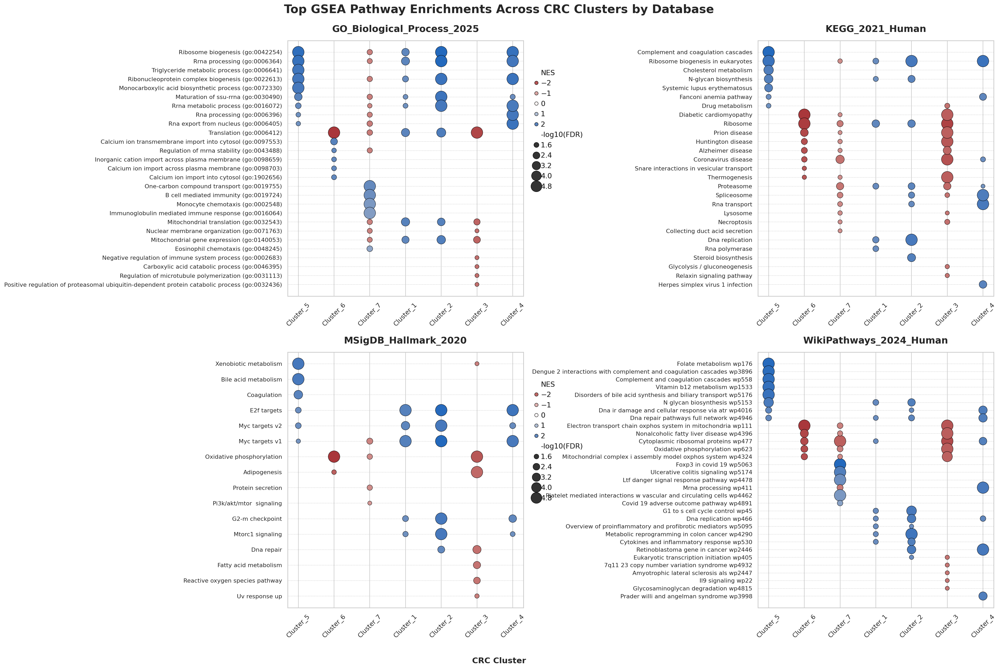

Faceted GSEA dot plot saved to:
  PNG: figures/GSEA_Faceted_DotPlot_2col.png
  PDF: figures/GSEA_Faceted_DotPlot_2col.pdf

--- GSEA analysis and visualization completed successfully. ---


In [18]:
# --- Step 3: Aggregate, Clean, and Parse GSEA Results ---
if not all_gsea_results:
    print("\nCRITICAL ERROR: GSEA analysis failed for all clusters. Cannot generate plots.")
else:
    full_gsea_df = pd.concat(all_gsea_results)
    full_gsea_df['NES'] = pd.to_numeric(full_gsea_df['NES'], errors='coerce')
    full_gsea_df['FDR q-val'] = pd.to_numeric(full_gsea_df['FDR q-val'], errors='coerce')
    
    significant_gsea_df = full_gsea_df.dropna(subset=['NES', 'FDR q-val'])
    significant_gsea_df = significant_gsea_df[significant_gsea_df['FDR q-val'] < 0.05].copy()
    
    if significant_gsea_df.empty:
        print("\nNo significantly enriched pathways found across all clusters at FDR < 0.05.")
    else:
        print(f"\nFound {len(significant_gsea_df)} significant pathway enrichments across all clusters.")
        
        # Engineer 'Database' and 'Pathway' columns from 'Term'
        significant_gsea_df[['Database', 'Pathway']] = significant_gsea_df['Term'].str.split('__', n=1, expand=True)
        significant_gsea_df['Pathway'] = significant_gsea_df['Pathway'].str.replace('_', ' ').str.capitalize()
        
    # --- Step 4: Generate a Faceted Dot Plot ---
    databases_to_plot = sorted(significant_gsea_df['Database'].unique())
    n_databases = len(databases_to_plot)

    ncols = 2
    nrows = int(np.ceil(n_databases / ncols))

    fig, axes = plt.subplots(
        nrows=nrows, 
        ncols=ncols, 
        figsize=(ncols * 12, nrows * 8),
        squeeze=False
    )
    axes = axes.flatten()

    fig.suptitle('Top GSEA Pathway Enrichments Across CRC Clusters by Database',
                 fontsize=20, weight='bold', y=0.99)

    for i, db_name in enumerate(databases_to_plot):
        ax = axes[i]
        print(f"\n--- Plotting for Database: {db_name} ---")
        
        db_df = significant_gsea_df[significant_gsea_df['Database'] == db_name]
        
        # Collect top pathways per cluster
        top_pathways = set()
        for cluster in sorted(db_df['Cluster'].unique()):
            cluster_db_df = db_df[db_df['Cluster'] == cluster]
            top_n = cluster_db_df.nlargest(5, 'NES')['Pathway']
            bottom_n = cluster_db_df.nsmallest(5, 'NES')['Pathway']
            top_pathways.update(top_n)
        
        if not top_pathways:
            ax.text(0.5, 0.5, f'No significant pathways to plot for\n{db_name}',
                    ha='center', va='center', fontsize=12)
            ax.set_title(db_name, fontsize=16, weight='bold', pad=15)
            ax.set_axis_off()
            continue

        plot_df = db_df[db_df['Pathway'].isin(top_pathways)].copy()
        
        min_nonzero = significant_gsea_df.loc[significant_gsea_df['FDR q-val'] > 0, 'FDR q-val'].min()
        if pd.isna(min_nonzero):
            # fallback to machine tiny if there are no non-zero q-values
            eps = np.nextafter(0.0, 1.0)
        else:
            eps = min_nonzero / 10.0

        plot_df['FDR_nonzero'] = plot_df['FDR q-val'].replace(0.0, eps)
        plot_df['-log10(FDR)'] = -np.log10(plot_df['FDR_nonzero'])
        # you can drop the helper column afterwards if you want
        plot_df.drop(columns=['FDR_nonzero'], inplace=True)


        sns.scatterplot(
            data=plot_df, x='Cluster', y='Pathway', hue='NES',
            size='-log10(FDR)', palette='vlag_r', sizes=(50, 400),
            ax=ax, edgecolor='black', linewidth=0.5
        )
        
        ax.set_title(db_name, fontsize=16, weight='bold', pad=15)
        ax.set_xlabel('')
        ax.set_ylabel('')
        ax.tick_params(axis='x', labelrotation=45, labelsize=11)
        ax.tick_params(axis='y', labelsize=10)
        ax.grid(True, which='major', axis='y', linestyle='--', linewidth=0.5)

        # --- Legends outside on the right ---
        handles, labels = ax.get_legend_handles_labels()
        unique_nes_vals = len(plot_df['NES'].unique())

        size_handles = handles[unique_nes_vals:]
        size_labels = labels[unique_nes_vals:]
        hue_handles = handles[:unique_nes_vals]
        hue_labels = labels[:unique_nes_vals]

        # Place NES legend (top)
        if hue_handles and hue_labels:
            leg1 = ax.legend(
                hue_handles, hue_labels,
                loc='center left',
                bbox_to_anchor=(1.02, 0.65),  # slightly above center
                title=None,
                frameon=False
            )
            ax.add_artist(leg1)

        # Place size legend (bottom)
        if size_handles and size_labels:
            ax.legend(
                size_handles, size_labels,
                loc='center left',
                bbox_to_anchor=(1.02, 0.25),  # slightly below center
                title='-log10(FDR)',
                frameon=False
            )

    # Remove unused axes if odd number of plots
    for j in range(i+1, len(axes)):
        axes[j].set_visible(False)

    fig.text(0.5, 0.01, 'CRC Cluster', ha='center', va='center',
             fontsize=14, weight='bold')
    
    plt.tight_layout(rect=[0, 0.03, 1, 1])  # leave right space for legends
    png_path = "figures/GSEA_Faceted_DotPlot_2col.png"
    pdf_path = "figures/GSEA_Faceted_DotPlot_2col.pdf"
    plt.savefig(png_path, dpi=300, bbox_inches='tight')
    plt.savefig(pdf_path, bbox_inches='tight')
    plt.show()

    print(f"Faceted GSEA dot plot saved to:\n  PNG: {png_path}\n  PDF: {pdf_path}")
    print("\n--- GSEA analysis and visualization completed successfully. ---")


---

#### ORA results

Overrepresentation analysis (ORA) tests whether predefined pathways are enriched among a set of significantly differentially expressed genes, offering a simpler and faster alternative to GSEA.

While ORA can be effective when the DEG list is large and robust, in this dataset it yielded few significantly enriched pathways, whereas GSEA, which uses all ranked genes and is less sensitive to arbitrary significance cutoffs, provided more informative results.

Back to [Table of Contents](#table-of-contents)


--- 9. ORA and Pathway Comparison, Visualized by Database ---
Found 7 DE result files to process.
Using Gene Set Libraries: MSigDB_Hallmark_2020, KEGG_2021_Human, GO_Biological_Process_2025, WikiPathways_2024_Human

>>> Processing ORA for Cluster_5 from file: DESeq2_mean_fit_Cluster_5_vs_Healthy.csv <<<
  Found 505 up-regulated and 1057 down-regulated genes.
  An error occurred during ORA for Cluster_5: Warning: No enrich terms when cutoff = 0.05

>>> Processing ORA for Cluster_6 from file: DESeq2_mean_fit_Cluster_6_vs_Healthy.csv <<<
  Found 253 up-regulated and 289 down-regulated genes.
  An error occurred during ORA for Cluster_6: Warning: No enrich terms when cutoff = 0.05

>>> Processing ORA for Cluster_7 from file: DESeq2_mean_fit_Cluster_7_vs_Healthy.csv <<<
  Found 13 up-regulated and 13265 down-regulated genes.
  An error occurred during ORA for Cluster_7: Warning: No enrich terms when cutoff = 0.05

>>> Processing ORA for Cluster_1 from file: DESeq2_mean_fit_Cluster_1_vs_Hea

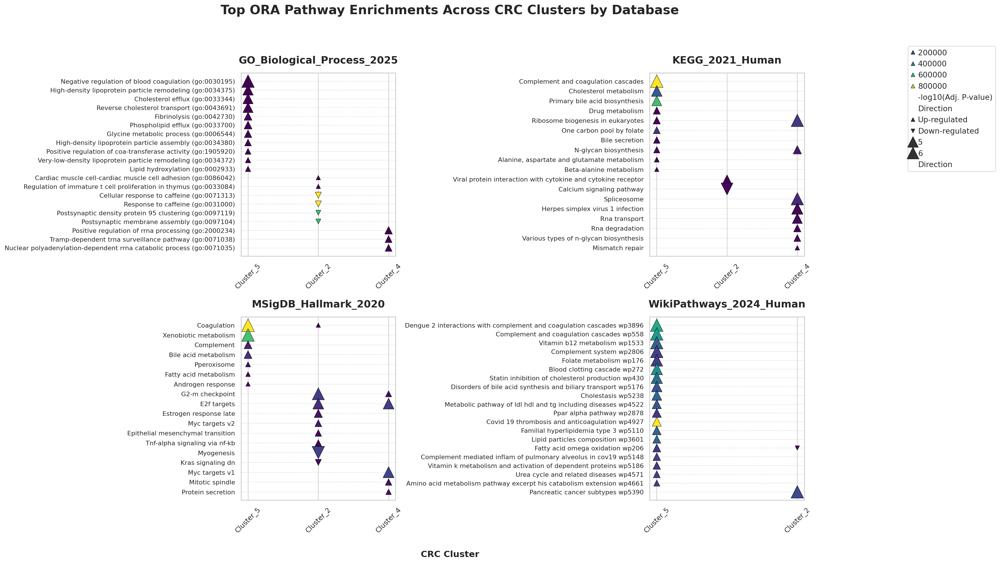


Faceted ORA dot plot saved to: figures/ORA_Faceted_DotPlot_Final.png and figures/ORA_Faceted_DotPlot_Final.pdf
All ORA analyses and visualizations are complete.


In [20]:
# --- 9. Over-Representation Analysis (ORA) with Faceted Dot Plot Visualization ---
print("\n--- 9. ORA and Pathway Comparison, Visualized by Database ---")

import os
import re
import gseapy as gp
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

# --- Step 1: Dynamically Find All DE Result Files ---
results_dir = "Hybrid_DE_Results/"
result_files = []
if not os.path.exists(results_dir):
    print(f"CRITICAL ERROR: Directory not found: {results_dir}.")
else:
    for filename in os.listdir(results_dir):
        if filename.endswith(".csv"):
            result_files.append(os.path.join(results_dir, filename))
print(f"Found {len(result_files)} DE result files to process.")

# --- Step 2: Loop Through Each File, Define Gene Lists, and Run ORA ---
gene_set_libraries = ['MSigDB_Hallmark_2020','KEGG_2021_Human', 'GO_Biological_Process_2025', 'WikiPathways_2024_Human']
print(f"Using Gene Set Libraries: {', '.join(gene_set_libraries)}")
all_ora_results = []

for file_path in result_files:
    try:
        match = re.search(r"Cluster_(\d+)_vs", os.path.basename(file_path))
        if not match: continue
        cluster_name = f"Cluster_{match.group(1)}"
        
        print(f"\n>>> Processing ORA for {cluster_name} from file: {os.path.basename(file_path)} <<<")
        
        results_df = pd.read_csv(file_path, index_col=0)
        
        # Define the background/universe as all genes tested
        background_genes = results_df.index.tolist()
        
        # Define significant UP-regulated genes
        up_genes = results_df[(results_df['padj'] < 0.05) & (results_df['log2FoldChange'] > 1.5)].index.tolist()
        
        # Define significant DOWN-regulated genes
        down_genes = results_df[(results_df['padj'] < 0.05) & (results_df['log2FoldChange'] < -1.5)].index.tolist()
        
        print(f"  Found {len(up_genes)} up-regulated and {len(down_genes)} down-regulated genes.")
        
        # Run ORA for UP-regulated genes
        if len(up_genes) > 10:
            ora_up = gp.enrichr(
                gene_list=up_genes, gene_sets=gene_set_libraries,
                background=len(background_genes), outdir=f"figures/ora_results/{cluster_name}_up",
                cutoff=0.05
            ).results
            ora_up['Direction'] = 'Up-regulated'
            ora_up['Cluster'] = cluster_name
            all_ora_results.append(ora_up)

        # Run ORA for DOWN-regulated genes
        if len(down_genes) > 10:
            ora_down = gp.enrichr(
                gene_list=down_genes, gene_sets=gene_set_libraries,
                background=len(background_genes), outdir=f"figures/ora_results/{cluster_name}_down",
                cutoff=0.05
            ).results
            ora_down['Direction'] = 'Down-regulated'
            ora_down['Cluster'] = cluster_name
            all_ora_results.append(ora_down)
            
    except Exception as e:
        print(f"  An error occurred during ORA for {cluster_name}: {e}")

# --- Step 3: Aggregate, Clean, and Parse ORA Results ---
if not all_ora_results:
    print("\nCRITICAL ERROR: ORA analysis failed for all clusters. Cannot generate plots.")
else:
    full_ora_df = pd.concat(all_ora_results)
    
    # Filter for significant results
    significant_ora_df = full_ora_df[full_ora_df['Adjusted P-value'] < 0.05].copy()
    
    if significant_ora_df.empty:
        print("\nNo significantly enriched pathways found across all clusters at Adjusted P-value < 0.05.")
    else:
        print(f"\nFound {len(significant_ora_df)} significant pathway enrichments across all clusters.")
        
        # Engineer 'Database' and 'Pathway' columns
        significant_ora_df['Database'] = significant_ora_df['Gene_set']
        significant_ora_df['Pathway'] = (
            significant_ora_df['Term']
            .str.replace(r'_\(GO:\d+\)', '', regex=True)
            .str.replace('_', ' ')
            .str.capitalize()
        )
        
        # --- Step 4: Generate a Faceted Dot Plot, One Panel Per Database ---
        databases_to_plot = sorted(significant_ora_df['Database'].unique())
        n_databases = len(databases_to_plot)
        
        # Arrange plots in 2 columns
        ncols = 2
        nrows = int(np.ceil(n_databases / ncols))
        
        # Increased width for better fit in 2x2 layout
        fig, axes = plt.subplots(
            nrows=nrows, ncols=ncols,
            figsize=(20, nrows * 6),  # width increased from 14 to 20
            squeeze=False
        )
        axes = axes.flatten()
        
        fig.suptitle(
            'Top ORA Pathway Enrichments Across CRC Clusters by Database',
            fontsize=20, weight='bold', y=1.02
        )
        
        for i, db_name in enumerate(databases_to_plot):
            ax = axes[i]
            print(f"\n--- Plotting for Database: {db_name} ---")
            
            db_df = significant_ora_df[significant_ora_df['Database'] == db_name]
            
            # Select top pathways based on Combined Score
            top_pathways = set(db_df.nlargest(20, 'Combined Score')['Pathway'])
            
            if not top_pathways:
                ax.text(0.5, 0.5, f'No pathways to plot for\n{db_name}',
                        ha='center', va='center')
                ax.set_title(db_name, fontsize=16, weight='bold', pad=15)
                ax.set_axis_off()
                continue
            
            plot_df = db_df[db_df['Pathway'].isin(top_pathways)].copy()
            plot_df['-log10(Adj. P-value)'] = -np.log10(plot_df['Adjusted P-value'] + 1e-10)
        
            sns.scatterplot(
                data=plot_df, x='Cluster', y='Pathway', hue='Combined Score',
                size='-log10(Adj. P-value)', style='Direction',
                markers={'Up-regulated': '^', 'Down-regulated': 'v'},
                palette='viridis', sizes=(50, 400),
                ax=ax, edgecolor='black', linewidth=0.5
            )
            
            ax.set_title(db_name, fontsize=16, weight='bold', pad=15)
            ax.set_xlabel('')
            ax.set_ylabel('')
            ax.tick_params(axis='x', labelrotation=45, labelsize=11)
            ax.tick_params(axis='y', labelsize=10)
            ax.grid(True, which='major', axis='y', linestyle='--', linewidth=0.5)
            
            if i == 0:
                handles, labels = ax.get_legend_handles_labels()
                legend_elements = [
                    *handles[1:6],
                    handles[-3],
                    *handles[-2:],
                    handles[-5],
                    *handles[-4:-2]
                ]
                fig.legend(handles=legend_elements, bbox_to_anchor=(1.0, 0.95), loc='upper left')
            ax.get_legend().remove()
        
        # Turn off empty subplots if n_databases is odd
        for j in range(i+1, len(axes)):
            axes[j].set_axis_off()
        
        fig.text(0.5, 0.01, 'CRC Cluster', ha='center', va='center', fontsize=14, weight='bold')
        plt.tight_layout(rect=[0, 0.03, 0.9, 0.98])
        
        # Save in PNG and PDF
        ora_plot_path_png = "figures/ORA_Faceted_DotPlot_Final.png"
        ora_plot_path_pdf = "figures/ORA_Faceted_DotPlot_Final.pdf"
        
        plt.savefig(ora_plot_path_png, dpi=300, bbox_inches='tight')
        plt.savefig(ora_plot_path_pdf, dpi=300, bbox_inches='tight')
        
        plt.show()
        print(f"\nFaceted ORA dot plot saved to: {ora_plot_path_png} and {ora_plot_path_pdf}")
        print("All ORA analyses and visualizations are complete.")

---

### 6. Survival Analysis

Perform survival analysis on identified clusters using **Kaplan-Meier curves** and **Cox proportional hazards models**.

Back to [Table of Contents](#table-of-contents)




--- Running Robust Survival Analysis Pipeline ---
All survival analysis results will be saved to: 'survival_analysis_results'

Step A: Preparing survival data...
Note: found and will remove 29 entries with time <= 0.
build_time_event: method=explicit:OS time|OS status, kept 601 rows, dropped 2169 rows due to missing time/event.
Event counts after build: {0: 479, 1: 122}
-> Time/event construction method: explicit:OS time|OS status
-> After grouping and filtering, 598 samples in 2 clusters (min samples per cluster = 3).
Overall event counts: {0: 477, 1: 121}

Step C: Kaplan-Meier analysis and plotting...
-> Global Log-Rank Test p-value for plot: 0.2815


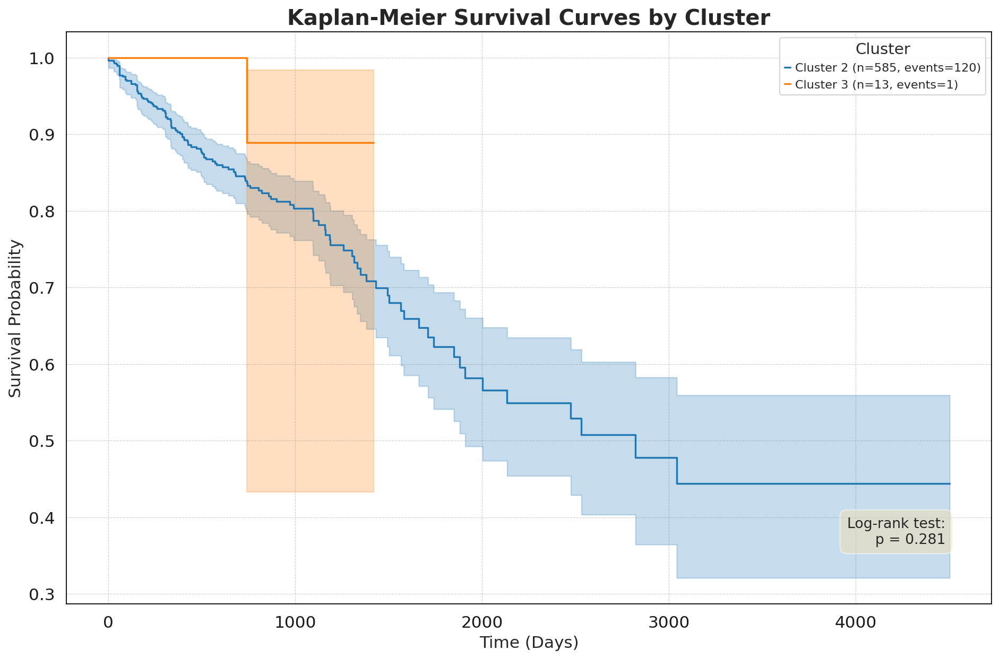

-> Saved Kaplan-Meier plot to: survival_analysis_results/Kaplan_Meier_by_Cluster.png

Step D: Log-rank tests...
-> Global Log-Rank Test p-value: 0.2815
-> Saved pairwise log-rank results to: survival_analysis_results/pairwise_logrank_results.csv

Step E: Cox proportional hazards model with diagnostics...
Requested covariates found (requested -> actual column):
  - Sample type -> Sample type
  - CRC_Age_Group -> CRC_Age_Group
  - Biopsy site -> Biopsy site
  - Gender -> Gender
  - CMS -> CMS
  - Stage_engineered -> Stage_engineered
  - KRAS mutation -> KRAS mutation
  - BRAF mutation -> BRAF mutation
  - TP53 mutation -> TP53 mutation
  - EGFR mutated -> EGFR mutated
  - Prior treatment -> Prior treatment
  - Age -> Age
  - Stage -> Stage
Rows before dropna: 598
Imputed missing age (Age) with median = 68.0
Rows after required dropna (time/event present): 598
Event distribution: {0: 477, 1: 121}
Categorical columns to encode: ['group', 'Sample type', 'CRC_Age_Group', 'Biopsy site', 'Gend

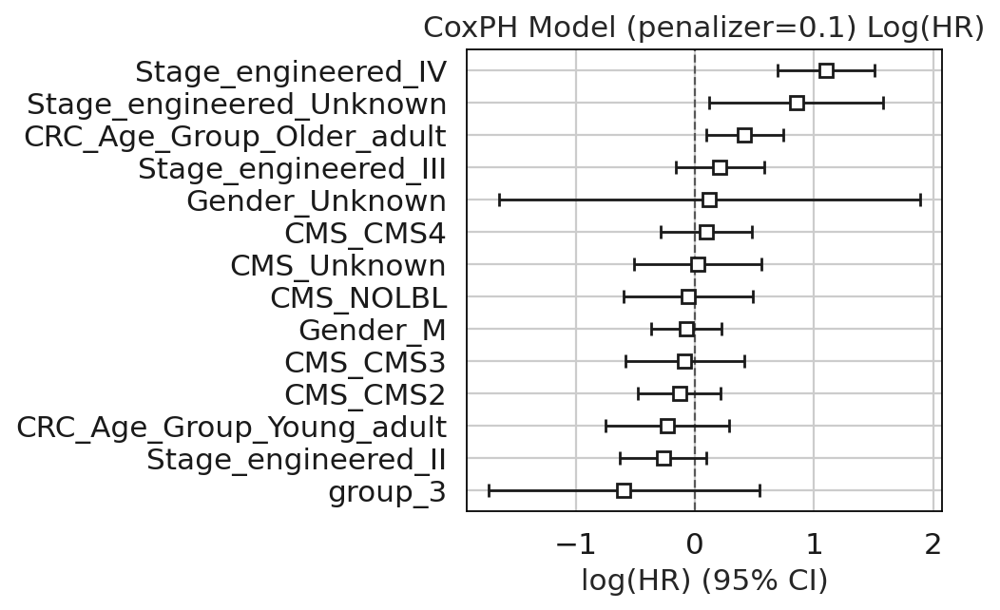


--- Checking Proportional Hazards Assumption (Schoenfeld residuals) ---

   Bootstrapping lowess lines. May take a moment...


   Bootstrapping lowess lines. May take a moment...


   Bootstrapping lowess lines. May take a moment...


   Bootstrapping lowess lines. May take a moment...


   Bootstrapping lowess lines. May take a moment...


   Bootstrapping lowess lines. May take a moment...


   Bootstrapping lowess lines. May take a moment...


   Bootstrapping lowess lines. May take a moment...


   Bootstrapping lowess lines. May take a moment...


   Bootstrapping lowess lines. May take a moment...


   Bootstrapping lowess lines. May take a moment...


   Bootstrapping lowess lines. May take a moment...


   Bootstrapping lowess lines. May take a moment...


   Bootstrapping lowess lines. May take a moment...

Proportional hazard assumption looks okay.
-> Assumption check plots saved to: survival_analysis_results/coxph_assumption_check_plots.png


<Figure size 800x480 with 0 Axes>

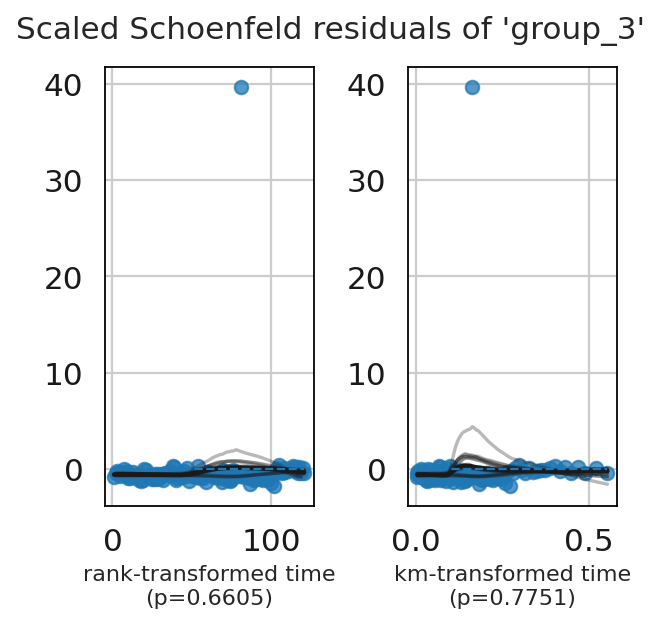

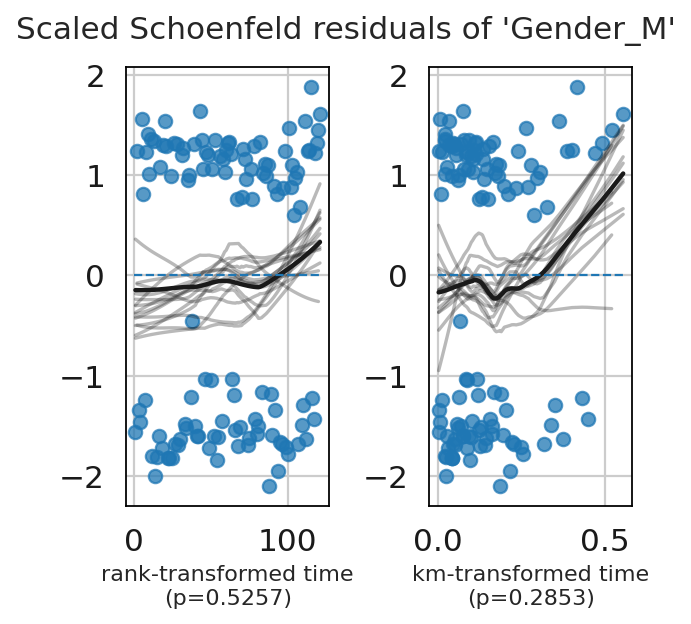

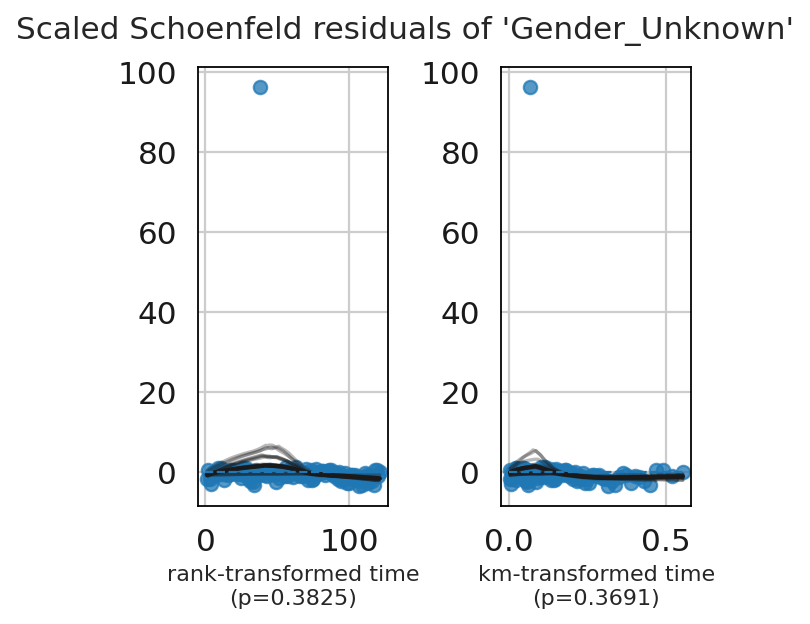

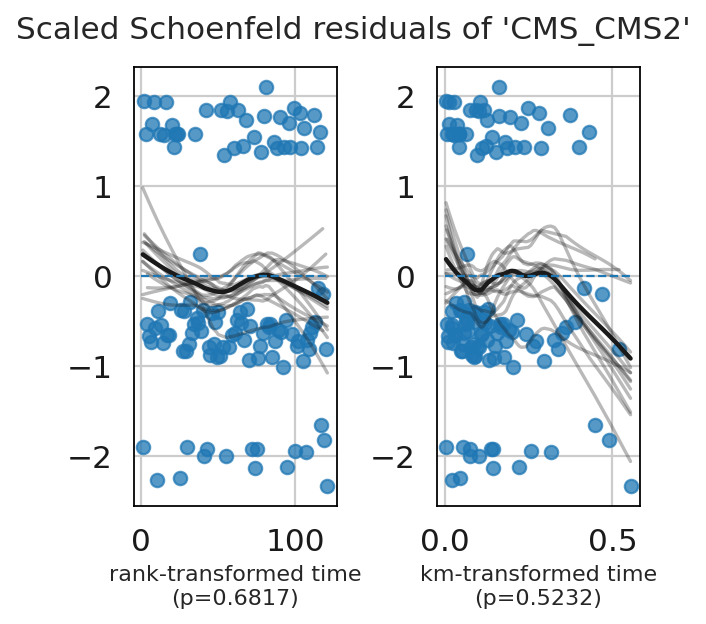

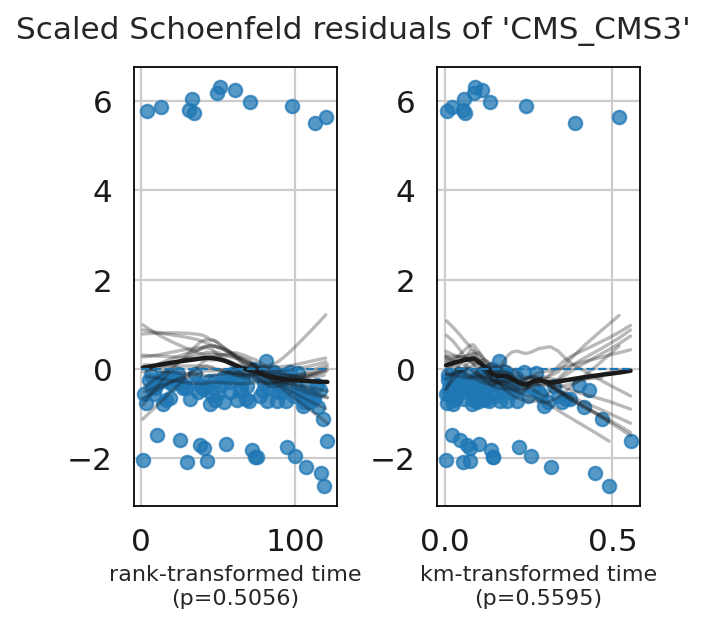

...

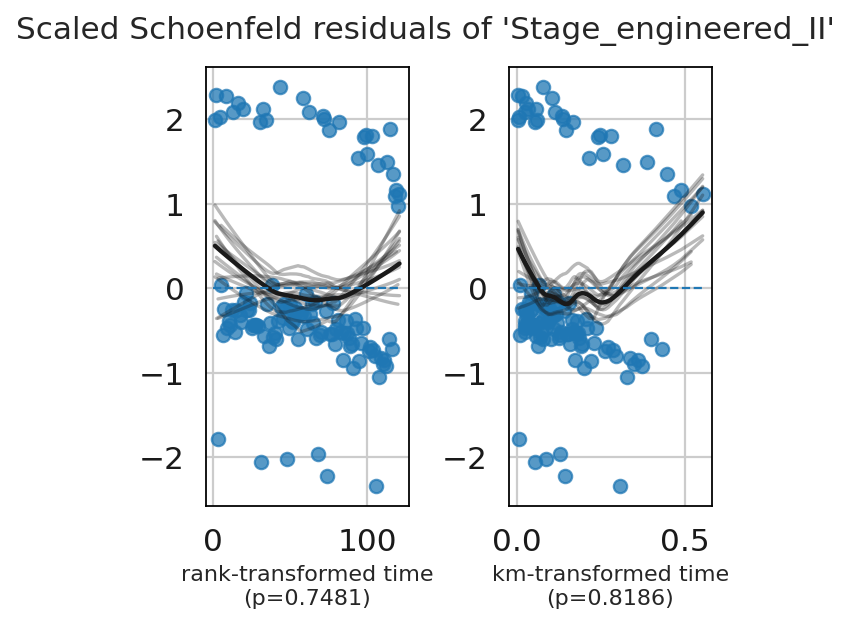

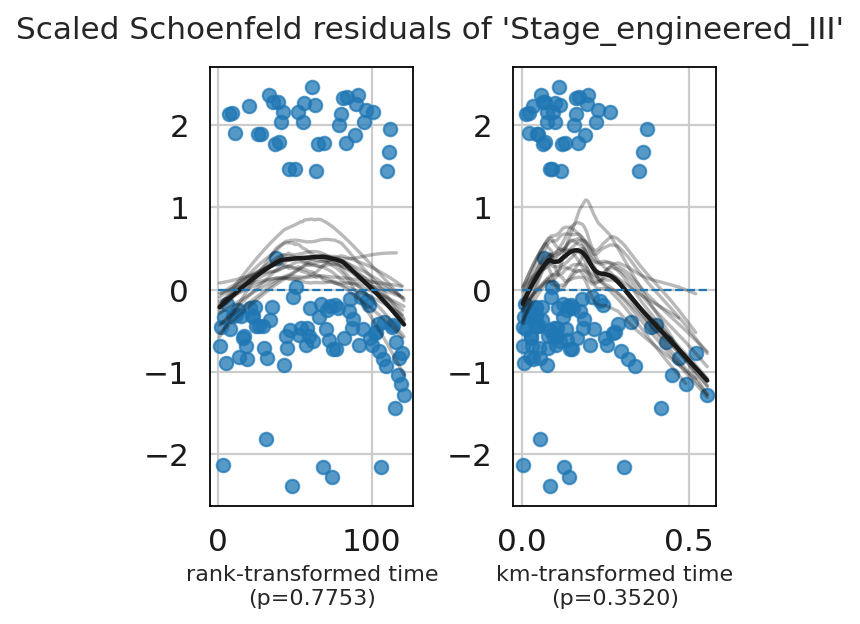

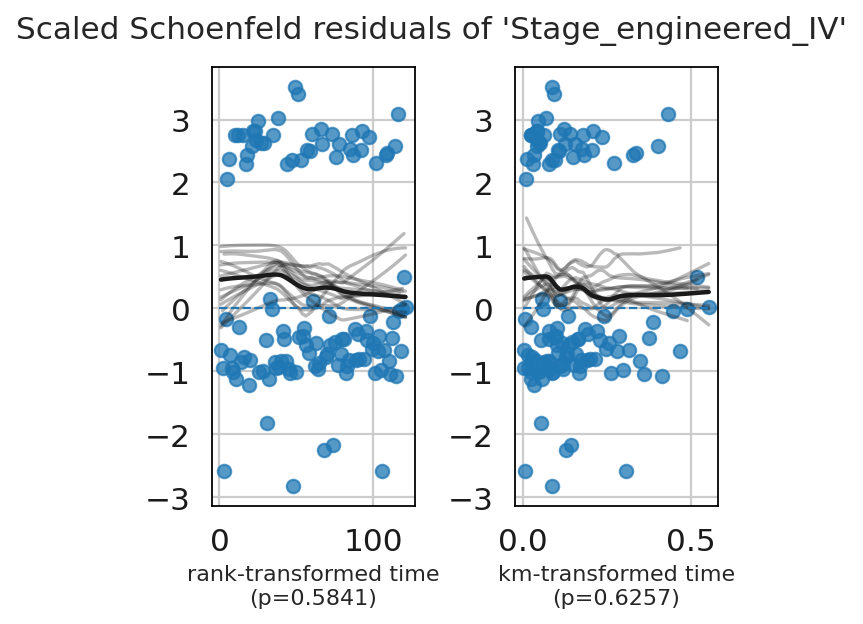

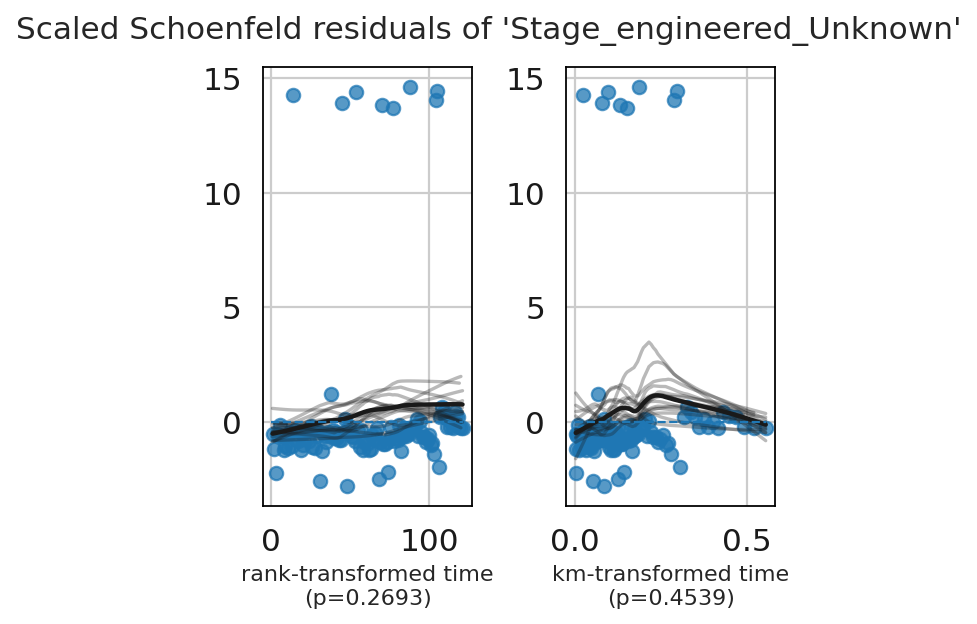

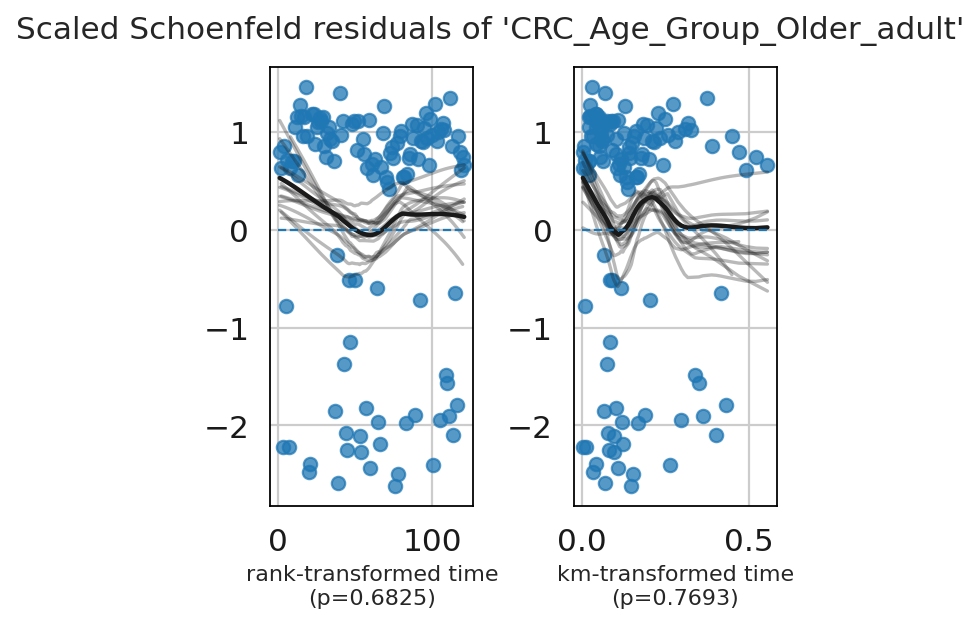

In [ ]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from lifelines import KaplanMeierFitter, CoxPHFitter
from lifelines.statistics import multivariate_logrank_test, logrank_test
from itertools import combinations

print("\n--- Running Robust Survival Analysis Pipeline ---")

# Recreate survival_subset_df as the clinical dataframe for survival analysis
# Survival Analysis Subset
survival_cols = ['OS time', 'OS status']
# Assuming 'processed_clinical_df' is loaded and available from a previous cell
# For example:
# processed_clinical_df = pd.read_csv('your_clinical_data.csv') 
def assign_crc_age_group(Age):
    if pd.isna(Age):
        return pd.NA
    elif Age < 50:
        return "Young_adult"
    elif Age <= 64:
        return "Middle-aged"
    else:
        return "Older_adult"

# Ensure age groups and previously defined clusters were assigned
processed_clinical_df[CRC_AGE_GROUP_COL] = processed_clinical_df[AGE_COL].apply(assign_crc_age_group)
processed_clinical_df['leiden_cluster'] = adata.obs['leiden_clusters']

survival_subset_df = processed_clinical_df.dropna(subset=survival_cols).copy()

# --- 1. Configuration & Prerequisites ---
OUTPUT_DIR = "survival_analysis_results"
os.makedirs(OUTPUT_DIR, exist_ok=True)
print(f"All survival analysis results will be saved to: '{OUTPUT_DIR}'")

MIN_SAMPLES_PER_GROUP = 3
MAX_GROUPS_TO_PLOT = 7

def find_column(df, candidates):
    for c in candidates:
        for col in df.columns:
            if col.lower() == c.lower():
                return col
    for c in candidates:
        for col in df.columns:
            if c.lower() in col.lower():
                return col
    return None

def map_status_series(s):
    s_lower = s.astype(str).str.strip().str.lower()
    mapping = {
        'dead': 1, 'deceased': 1, 'died': 1, 'death': 1, '1': 1, 'yes': 1, 'event': 1, 'true': 1,
        'alive': 0, 'living': 0, '0': 0, 'no': 0, 'censored': 0, 'na': np.nan, 'nan': np.nan
    }
    mapped = s_lower.map(mapping)
    if mapped.isna().all():
        try:
            numeric = pd.to_numeric(s, errors='coerce')
            if set(numeric.dropna().unique()).issubset({0,1}):
                mapped = numeric
        except Exception:
            pass
    return mapped

def build_time_event(df):
    time_cands = [
        'OS time','os_time','os.time','overall_survival_time','overall_survival_days',
        'days_to_death','days_to_last_followup','days_to_last_follow_up','followup_time','time_to_event','survival_time','time'
    ]
    status_cands = [
        'OS status','os_status','vital_status','status','overall_survival_status',
        'death_event','deceased','event','vital.status'
    ]
    time_col = find_column(df, time_cands)
    status_col = find_column(df, status_cands)

    out = df.copy()
    used_method = None

    if time_col and status_col:
        out['time_raw'] = out[time_col]
        out['event_raw'] = out[status_col]
        out['time'] = pd.to_numeric(out['time_raw'], errors='coerce')
        out['event'] = map_status_series(out['event_raw']).astype('float').astype('Int64')
        used_method = f"explicit:{time_col}|{status_col}"
    else: # TCGA style fallback
        dt_death = find_column(out, ['days_to_death'])
        dt_last = find_column(out, ['days_to_last_followup','days_to_last_follow_up'])
        vital = find_column(out, ['vital_status'])
        if dt_death or dt_last:
            d_death = out[dt_death] if dt_death else pd.Series([np.nan]*len(out), index=out.index)
            d_last = out[dt_last] if dt_last else pd.Series([np.nan]*len(out), index=out.index)
            out['time'] = d_death.fillna(d_last)
            out['event'] = (~d_death.isna()).astype(int)
            used_method = f"tcga_days:{dt_death}|{dt_last}"
            if vital:
                vital_mapped = map_status_series(out[vital])
                mask_fix = (vital_mapped == 1) & out['event'].isna()
                out.loc[mask_fix, 'event'] = 1
        else:
            used_method = "no_time_status_found"
            out['time'] = np.nan
            out['event'] = pd.Series([pd.NA]*len(out), index=out.index)

    out['time'] = pd.to_numeric(out['time'], errors='coerce')
    if out['event'].dtype.name.startswith('Int') or pd.api.types.is_integer_dtype(out['event']):
        out['event'] = out['event'].astype('Int64')
    else:
        out['event'] = map_status_series(out['event']).astype('Float64').astype('Int64')

    neg_count = int((out['time'] <= 0).sum())
    if neg_count > 0:
        print(f"Note: found and will remove {neg_count} entries with time <= 0.")
        out.loc[out['time'] <= 0, ['time', 'event']] = pd.NA

    tmax = out['time'].max(skipna=True)
    n_nonnull = out['time'].notnull().sum()
    frac_ratio = ((out['time'] % 1 != 0).sum() / max(1, n_nonnull)) if n_nonnull else 0
    converted_from_years = False
    if tmax is not None and not np.isnan(tmax):
        if tmax <= 30 and frac_ratio > 0.2:
            out['time'] = out['time'] * 365.25
            converted_from_years = True
            print("Heuristic: converted time from years to days by multiplying by 365.25.")

    out['event'] = out['event'].astype('Int64')
    before_drop = len(out)
    out = out.dropna(subset=['time', 'event'])
    dropped = before_drop - len(out)
    print(f"build_time_event: method={used_method}, kept {len(out)} rows, dropped {dropped} rows due to missing time/event.")
    if len(out) > 0:
        print("Event counts after build:", out['event'].value_counts(dropna=False).to_dict())
    return out, used_method, converted_from_years

# --- 2. Survival Analysis Pipeline ---
try:
    print("\nStep A: Preparing survival data...")
    if 'processed_clinical_df' not in locals():
        raise NameError("The required DataFrame 'processed_clinical_df' was not found.")

    built_df, method_used, converted_flag = build_time_event(processed_clinical_df)
    print(f"-> Time/event construction method: {method_used}")

    if built_df['event'].sum() == 0 or built_df['event'].isna().all():
        print("Warning: no events found in OS construction, attempting PFS fallback...")
        pfs_time_col = find_column(processed_clinical_df, ['PFS time','pfs_time','progression_free_survival_time'])
        pfs_status_col = find_column(processed_clinical_df, ['PFS status','pfs_status'])
        if pfs_time_col and pfs_status_col:
            pf = processed_clinical_df.copy()
            pf['time'] = pd.to_numeric(pf[pfs_time_col], errors='coerce')
            pf['event'] = map_status_series(pf[pfs_status_col]).astype('Int64')
            pf = pf.dropna(subset=['time','event'])
            if converted_flag and pf['time'].max() <= 30 and ((pf['time'] % 1 != 0).sum()/max(1, len(pf)) > 0.2):
                pf['time'] = pf['time'] * 365.25
            if len(pf) > 0 and pf['event'].sum() > 0:
                built_df = pf
                print("-> Using PFS as fallback endpoint.")
            else:
                print("-> PFS fallback also contains no events or is empty.")
        else:
            print("-> No usable PFS columns found for fallback.")

    if built_df.empty:
        print("No usable survival records could be constructed. Stopping analysis.")
    else:
        # ** MODIFICATION 1: Prioritize the cluster ID column **
        group_col = find_column(built_df, ['leiden_cluster', 'leiden_clusters','cluster', 'cluster_label', 'group'])
        if not group_col:
            raise ValueError("A 'leiden cluster' or equivalent column could not be found in the data.")

        analysis_df = built_df.rename(columns={group_col: 'group'}).copy()
        analysis_df['group'] = analysis_df['group'].astype('category')
        analysis_df['time'] = pd.to_numeric(analysis_df['time'], errors='coerce')
        analysis_df['event'] = pd.to_numeric(analysis_df['event'], errors='coerce').fillna(0).astype(int)

        group_counts = analysis_df['group'].value_counts()
        groups_to_include = group_counts[group_counts >= MIN_SAMPLES_PER_GROUP].index.tolist()
        analysis_df = analysis_df[analysis_df['group'].isin(groups_to_include)].copy()

        print(f"-> After grouping and filtering, {len(analysis_df)} samples in {len(groups_to_include)} clusters (min samples per cluster = {MIN_SAMPLES_PER_GROUP}).")
        print("Overall event counts:", analysis_df['event'].value_counts().to_dict())

        if analysis_df.empty:
            print("No groups met the minimum sample threshold. Stopping survival analysis.")
        else:
            # --- Step C: Kaplan-Meier ---
            print("\nStep C: Kaplan-Meier analysis and plotting...")

            # ** MODIFICATION 2: Calculate Global P-value Before Plotting **
            global_p_value = None
            if len(groups_to_include) > 1:
                try:
                    global_test = multivariate_logrank_test(analysis_df['time'], analysis_df['group'], analysis_df['event'])
                    global_p_value = global_test.p_value
                    print(f"-> Global Log-Rank Test p-value for plot: {global_p_value:.4g}")
                except Exception as e:
                    print(f"-> Could not calculate global log-rank test for plot: {e}")

            kmf = KaplanMeierFitter()
            fig, ax = plt.subplots(figsize=(12, 8))
            
            plotted = 0
            for i, group in enumerate(sorted(groups_to_include)[:MAX_GROUPS_TO_PLOT]):
                mask = (analysis_df['group'] == group)
                n_events = analysis_df.loc[mask, 'event'].sum()
                n_total = mask.sum()
                if n_events == 0:
                    print(f"Skipping cluster {group}: zero events (n={n_total}).")
                    continue
                kmf.fit(analysis_df.loc[mask, 'time'], analysis_df.loc[mask, 'event'],
                        label=f"Cluster {group} (n={n_total}, events={int(n_events)})")
                kmf.plot_survival_function(ax=ax, ci_show=True)
                plotted += 1

            if plotted == 0:
                print("No clusters with events available to plot Kaplan-Meier curves.")
            else:
                ax.set_title(f"Kaplan-Meier Survival Curves by Cluster", fontsize=18, weight='bold')
                ax.set_xlabel("Time (Days)", fontsize=14)
                ax.set_ylabel("Survival Probability", fontsize=14)
                ax.grid(True, which='major', linestyle='--', linewidth=0.5)
                ax.legend(title="Cluster", fontsize=10)

                # ** MODIFICATION 2: Add the p-value text to the plot **
                if global_p_value is not None:
                    if global_p_value < 0.001:
                        p_text = "p < 0.001"
                    else:
                        p_text = f"p = {global_p_value:.3f}"
                    ax.text(0.95, 0.1, f"Log-rank test:\n{p_text}", 
                            transform=ax.transAxes, 
                            fontsize=12, 
                            verticalalignment='bottom', 
                            horizontalalignment='right',
                            bbox=dict(boxstyle='round,pad=0.5', fc='wheat', alpha=0.5))
                
                plt.tight_layout()
                km_plot_path = os.path.join(OUTPUT_DIR, "Kaplan_Meier_by_Cluster.png")
                plt.savefig(km_plot_path, dpi=300)
                plt.show()
                print(f"-> Saved Kaplan-Meier plot to: {km_plot_path}")

            # --- Step D: Log-Rank Tests ---
            print("\nStep D: Log-rank tests...")
            if len(groups_to_include) > 1:
                # The global test is already done above, but we can print it again for the log
                if global_p_value is not None:
                     print(f"-> Global Log-Rank Test p-value: {global_p_value:.4g}")

                pairwise_results = []
                for group1, group2 in combinations(sorted(groups_to_include), 2):
                    mask1 = (analysis_df['group'] == group1)
                    mask2 = (analysis_df['group'] == group2)
                    if analysis_df.loc[mask1, 'event'].sum() == 0 or analysis_df.loc[mask2, 'event'].sum() == 0:
                        continue
                    try:
                        result = logrank_test(analysis_df.loc[mask1, 'time'], analysis_df.loc[mask2, 'time'],
                                              analysis_df.loc[mask1, 'event'], analysis_df.loc[mask2, 'event'])
                        pairwise_results.append({'cluster_1': group1, 'cluster_2': group2, 'p_value': result.p_value})
                    except Exception as e:
                        print(f"-> Pairwise test failed for {group1} vs {group2}: {e}")

                if pairwise_results:
                    pairwise_df = pd.DataFrame(pairwise_results).sort_values('p_value').reset_index(drop=True)
                    pairwise_path = os.path.join(OUTPUT_DIR, "pairwise_logrank_results.csv")
                    pairwise_df.to_csv(pairwise_path, index=False)
                    print(f"-> Saved pairwise log-rank results to: {pairwise_path}")
                else:
                    print("-> No valid pairwise comparisons could be made.")


            # --- Step E: Robust Cox Proportional Hazards Model with Diagnostics ---
            print("\nStep E: Cox proportional hazards model with diagnostics...")

            # Helper to coerce binary/mutation-like columns to clean categories
            def _coerce_binary_like_to_category(s: pd.Series, mutated_labels=('mut', 'mutated', 'alt', '1', 'yes', 'true', 'pos', 'positive')):
                v = s.astype(str).str.strip().str.lower().replace({'nan': np.nan, 'na': np.nan, 'none': np.nan})
                # common wild-type/negative tokens
                wt_tokens = {'wt', 'wildtype', 'wild-type', '0', 'no', 'false', 'neg', 'negative', 'not mutated', 'wild type'}
                mut_tokens = set(mutated_labels)
                out = pd.Series(index=s.index, dtype=object)

                out[v.isin(mut_tokens)] = 'Mutated'
                out[v.isin(wt_tokens)] = 'WT'

                # if something looks like 0/1 numerically, map those
                as_num = pd.to_numeric(v, errors='coerce')
                out[as_num == 1] = 'Mutated'
                out[as_num == 0] = 'WT'

                # keep other strings as-is (e.g., 'Unknown', 'N/A', etc.)
                out[v.isna()] = np.nan
                mask_unmapped = out.isna() & v.notna()
                out.loc[mask_unmapped] = s.loc[mask_unmapped].astype(str).replace({'': np.nan})
                return out.astype('object')

            # 1) Build candidate covariates list (keep 'group', add requested clinical variables when present)
            covariates = ['group']

            ADDL_COV_CANDIDATES = [
                'Sample type','CRC_Age_Group','Biopsy site','Gender','CMS','Stage_engineered',
                'KRAS mutation','BRAF mutation','TP53 mutation','EGFR mutated','Prior treatment'
            ]

            matched_covs = {}
            for cov in ADDL_COV_CANDIDATES:
                found = find_column(analysis_df, [cov])
                if found and found not in covariates:
                    covariates.append(found)
                    matched_covs[cov] = found

            # (Optionally still try generic Age/Stage names if present)
            for cov in ['Age', 'age', 'Stage', 'stage']:
                c = find_column(analysis_df, [cov])
                if c and c not in covariates:
                    covariates.append(c)
                    matched_covs[cov] = c

            print("Requested covariates found (requested -> actual column):")
            for req, act in matched_covs.items():
                print(f"  - {req} -> {act}")

            # 2) Assemble model_df with time/event + covariates
            model_df = analysis_df[['time', 'event'] + [c for c in covariates if c in analysis_df.columns]].copy()
            print("Rows before dropna:", len(model_df))

            # 3) Impute/clean numeric age if present
            age_col = find_column(model_df, ['Age','age'])
            if age_col:
                model_df[age_col] = pd.to_numeric(model_df[age_col], errors='coerce')
                med_age = model_df[age_col].median(skipna=True)
                model_df[age_col] = model_df[age_col].fillna(med_age)
                print(f"Imputed missing age ({age_col}) with median = {med_age:.1f}")

            # 4) Normalize categorical columns (including mutation-like fields)
            # Treat everything except numeric age as categorical
            for col in [c for c in model_df.columns if c not in ['time','event', age_col] if c in model_df.columns]:
                # mutation-like?
                if any(tok in col.lower() for tok in ['kras', 'braf', 'tp53', 'egfr', 'mutation', 'mutated']):
                    model_df[col] = _coerce_binary_like_to_category(model_df[col]).fillna('Unknown').astype('object')
                else:
                    model_df[col] = model_df[col].astype('object').fillna('Unknown')

            # Ensure time/event present
            model_df = model_df.dropna(subset=['time', 'event'])
            print("Rows after required dropna (time/event present):", len(model_df))
            print("Event distribution:", model_df['event'].value_counts().to_dict())

            n_events = int(model_df['event'].sum())
            if n_events == 0:
                print("-> ERROR: No events remain in model_df. Cannot fit CoxPH.")
            else:
                # 5) One-hot encode categoricals (including 'group'); keep numeric age if any
                cat_cols = model_df.select_dtypes(include=['object', 'category']).columns.tolist()
                if 'group' in model_df.columns and 'group' not in cat_cols:
                    cat_cols.append('group')

                print("Categorical columns to encode:", cat_cols)
                model_df_encoded = pd.get_dummies(model_df, columns=cat_cols, drop_first=True, dtype=float)

                # Drop problematic columns
                nan_cols = model_df_encoded.columns[model_df_encoded.isna().any()].tolist()
                if nan_cols:
                    print("Dropping columns with NaN after encoding:", nan_cols)
                    model_df_encoded = model_df_encoded.drop(columns=nan_cols)

                inf_cols = model_df_encoded.columns[np.isinf(model_df_encoded).any()].tolist()
                if inf_cols:
                    print("Dropping columns with inf after encoding:", inf_cols)
                    model_df_encoded = model_df_encoded.drop(columns=inf_cols)

                const_cols = model_df_encoded.columns[model_df_encoded.nunique() <= 1].tolist()
                if const_cols:
                    print("Dropping constant columns:", const_cols)
                    model_df_encoded = model_df_encoded.drop(columns=const_cols)

                if 'time' not in model_df_encoded.columns or 'event' not in model_df_encoded.columns:
                    raise ValueError("time or event column missing after encoding")

                p = model_df_encoded.shape[1] - 2
                epv = n_events / max(1, p)
                print(f"Number of events = {n_events}; candidate predictors = {p}; events per predictor ≈ {epv:.2f}")

                # Restrict if EPV is low
                if epv < 5:
                    print("Warning: events per predictor is low (<5). Fitting a conservative model with 'group' and key clinicals only.")
                    keep = ['time', 'event'] + [c for c in model_df_encoded.columns if c.startswith('group_')]
                    # keep top-level clinicals if present
                    for base in ['Gender', 'CMS', 'Stage_engineered', 'CRC_Age_Group', 'Sample type', 'Biopsy site',
                                'KRAS mutation','BRAF mutation','TP53 mutation','EGFR mutated','Prior treatment']:
                        # collect any dummy columns that start with these names (case-insensitive)
                        keep += [c for c in model_df_encoded.columns if c.lower().startswith(base.lower().replace(' ', '_'))]
                    # de-duplicate preserving order
                    seen = set()
                    keep = [c for c in keep if (c not in seen and not seen.add(c))]
                    keep = [c for c in keep if c in model_df_encoded.columns]
                    model_to_fit = model_df_encoded[keep]
                else:
                    model_to_fit = model_df_encoded

                if model_to_fit.isna().any().any():
                    print("Final model dataframe still contains NaNs. Dropping rows with NaNs.")
                    model_to_fit = model_to_fit.dropna()

                n_events_final = int(model_to_fit['event'].sum())
                if n_events_final == 0:
                    print("-> ERROR: No events available after final cleaning. Cannot fit CoxPH.")
                else:
                    cph = CoxPHFitter()
                    fit_succeeded = False
                    successful_penalizer = None

                    for penal in [0.1, 1.0, 5.0]:
                        try:
                            print(f"Attempting CoxPH fit with penalizer={penal} ...")
                            cph = CoxPHFitter(penalizer=penal)
                            cph.fit(model_to_fit, duration_col='time', event_col='event')
                            print(f"-> CoxPH fitted successfully with penalizer={penal}")
                            fit_succeeded = True
                            successful_penalizer = penal
                            break
                        except Exception as e:
                            print(f"Penalizer={penal} failed: {e}")

                    if not fit_succeeded:
                        print("All penalized fits failed. Consider simpler models or univariate Cox analyses.")
                    else:
                        cox_path = os.path.join(OUTPUT_DIR, "cox_proportional_hazards_summary.csv")
                        cph.summary.to_csv(cox_path)
                        print(f"-> Summary saved to: {cox_path}")

                        cph.plot()
                        plt.title(f"CoxPH Model (penalizer={successful_penalizer}) Log(HR)")
                        plt.savefig(os.path.join(OUTPUT_DIR, f"coxph_summary_plot.png"), bbox_inches='tight')
                        plt.show()

                        print("\n--- Checking Proportional Hazards Assumption (Schoenfeld residuals) ---")
                        try:
                            plt.figure(figsize=(10, 6))
                            cph.check_assumptions(model_to_fit, p_value_threshold=0.05, show_plots=True)
                            assumption_plot_path = os.path.join(OUTPUT_DIR, f"coxph_assumption_check_plots.png")
                            plt.suptitle(f"Proportional Hazards Assumption Check (Penalizer={successful_penalizer})", y=1.02)
                            plt.tight_layout()
                            plt.savefig(assumption_plot_path, dpi=100)
                            plt.close()
                            print("-> Assumption check plots saved to:", assumption_plot_path)
                        except Exception as e:
                            print(f"-> Could not perform proportional hazards assumption check: {e}")
except Exception as e:
    print(f"\n--- An unexpected error occurred in the pipeline: {e} ---")




Back to [Table of Contents](#table-of-contents)

---
### 7. Concluding Notes

This comprehensive analysis of colorectal cancer (CRC) bulk RNA-seq data has successfully identified and characterized distinct molecular subpopulations within the cohort, revealing significant associations with clinical features and patient outcomes.

**Overall Findings:**

-   Identification of Novel CRC Subtypes: Through unsupervised clustering using fine-tuned parameter settings, and Leiden algorithm, we identified several distinct molecular clusters within the large cohort of this dataset.

-   Namingly 'Cluster 0' was almost perfectly populated by the healthy donor samples. Rest of the clusters, 'Clusters 1 to 7' were populated by primary CRC samples.
  
-   These clusters represent potentially novel subtypes of CRC that are not captured by traditional classification methods.

-   Clinical and Molecular Characterization of Subtypes: Chi-Square tests revealed significant associations between the identified Leiden clusters and key clinical variables, including Consensus Molecular Subtype (CMS), Stage, Age, and tumor location. This indicates that the identified clusters are not only molecularly distinct but also clinically relevant. However this relevance was more complicated than I have anticipated, it is not explainable by linear associations, at least with the large scale of the missing values of the clinical data of this cohort.

-   Prognostic Significance of Subtypes: Survival analysis demonstrated that the identified clusters have different survival probabilities, with 'Cluster 3' showing worse prognoses than 'Cluster 2'. This finding may highlight the potential of these CRC subtypes as prognostic biomarkers. However, event sizes were not sufficient to come up with statistically significant outcome (log-rank t-test, p-value = 0.281).

-   Biological Insights from DE and Pathway Enrichment Analysis: Differential expression (DE) analysis between each CRC cluster and healthy samples identified thousands of differentially expressed genes (DEGs), even with the strict Bonferroni multiple-test correction.
Pathway enrichment analysis (GSEA and ORA) of these differential tests revealed that the clusters are characterized by distinct biological processes. Key cancer-related pathways, including metabolic reprogramming, cell cycle regulation, and signaling pathways like Wnt, Myc, and TGF-beta, were found to be enriched in different clusters, providing insights into the underlying biology of each subtype. However, these findings were not immediately trasnferable to the known 4 CMS stages of CRC, at least not easily for me.

**Challenges Encountered:**

-   Missing Clinical Data: A major challenge in this analysis was the high percentage of missing values in the clinical dataset. This limited the statistical power of some analyses and could introduce potential biases in the interpretation of the results.

-   Bulk RNA-seq Limitations: The use of bulk RNA-seq data provides an average gene expression profile across a heterogeneous population of cells within the tumor microenvironment. This can obscure the gene expression signatures of rare but potentially important cell types, such as specific immune cell populations.


**Future Improvements and Scalability:**

-   Addressing Missing Data: To improve the robustness of the analysis, future work could focus on using advanced imputation methods to handle missing clinical data or performing analyses on a more complete subset of the cohort.

-   Cell type deconvolution: Estimating immune cell type fractions (using [CellAnneal](https://doi.org/10.21105/joss.05610)) can provide valuable insights into sample-specific cellular composition, helping to capture the heterogeneity within this large CRC cohort.

-   Integration of Single-Cell Data: To overcome the limitations of bulk RNA-seq, future studies could incorporate single-cell RNA sequencing (scRNA-seq) data. This would allow for a more detailed characterization of the cellular heterogeneity within each tumor subtype and the identification of cell-type-specific gene expression patterns.
  
-   Validation in Independent Cohorts: The prognostic gene signatures identified in this study should be validated in independent CRC cohorts to confirm their clinical utility.
  
-   Scalability and Reusability: The analysis pipeline developed in this notebook is scalable and can be readily applied to other bulk RNA-seq datasets from different cancer types. The identified gene signatures could also be used to develop a molecular classifier for stratifying patients and guiding personalized treatment strategies in future clinical applications.-   

---

Back to [Table of Contents](#table-of-contents)

